# Colab

In [1]:
!nvidia-smi -L  

GPU 0: NVIDIA GeForce RTX 3060 (UUID: GPU-4f491c34-8f68-4f27-fe8a-69387b201d88)


In [2]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Fri Feb 14 18:07:20 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 566.36                 Driver Version: 566.36         CUDA Version: 12.7     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                  Driver-Model | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA GeForce RTX 3060      WDDM  |   00000000:01:00.0  On |                  N/A |
| 41%   38C    P8             12W /  170W |    1251MiB /  12288MiB |      7%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [3]:
from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('Not using a high-RAM runtime')
else:
  print('You are using a high-RAM runtime!')

Your runtime has 68.5 gigabytes of available RAM

You are using a high-RAM runtime!


In [45]:
# !pip install torch==1.4.0 torchvision==0.5.0

In [46]:
!pip uninstall albumentations -y

Found existing installation: albumentations 1.0.3
Uninstalling albumentations-1.0.3:
  Successfully uninstalled albumentations-1.0.3


In [47]:
 !pip install albumentations==1.0.3

In [48]:
!pip uninstall opencv-python-headless -y

Found existing installation: opencv-python-headless 4.10.0.84
Uninstalling opencv-python-headless-4.10.0.84:
  Successfully uninstalled opencv-python-headless-4.10.0.84


In [49]:
!pip install opencv-python-headless==4.10.0.84

   ---------------------------------------- 0.0/38.8 MB ? eta -:--:--
    --------------------------------------- 0.5/38.8 MB 3.4 MB/s eta 0:00:12
   - -------------------------------------- 1.3/38.8 MB 3.5 MB/s eta 0:00:11
   - -------------------------------------- 1.8/38.8 MB 3.5 MB/s eta 0:00:11
   -- ------------------------------------- 2.6/38.8 MB 3.5 MB/s eta 0:00:11
   --- ------------------------------------ 3.4/38.8 MB 3.5 MB/s eta 0:00:11
   ---- ----------------------------------- 3.9/38.8 MB 3.5 MB/s eta 0:00:11
   ---- ----------------------------------- 4.7/38.8 MB 3.4 MB/s eta 0:00:10
   ----- ---------------------------------- 5.5/38.8 MB 3.5 MB/s eta 0:00:10
   ------ --------------------------------- 6.3/38.8 MB 3.5 MB/s eta 0:00:10
   ------- -------------------------------- 6.8/38.8 MB 3.5 MB/s eta 0:00:10
   ------- -------------------------------- 7.6/38.8 MB 3.5 MB/s eta 0:00:09
   -------- ------------------------------- 8.4/38.8 MB 3.5 MB/s eta 0:00:09
   ---

In [4]:
import albumentations
albumentations.__version__

'1.0.3'

In [53]:
## Remember focal loss order (targets outputs)
## accurqaacy _m tensor

# Load Data

In [2]:
import os
import pandas as pd
import pandas as pd
import seaborn as sns
from glob import glob
PATH = '/content/2019'

In [49]:
import random
import matplotlib.pyplot as plt
import numpy as np
import cv2
def visualize_images(df, target=np.random.randint(8) ,row_col=(4,4), figsize=(12,12), microscopy_crop=False):
  plt.figure(figsize=figsize)
  plt.tight_layout
  p = np.array(df[df['target']==target].loc[:,'path'])
  t = np.array(df[df['target']==target].loc[:,'diagnosis'])
  row, col = row_col
  for k in range(row*col):
    try:
      r = np.random.randint(len(t)-1)
    except:
      continue
    l = t[r];i = p[r]
    img = cv2.imread(i); 
    img = cv2.resize(img, (224,224))
    if microscopy_crop:
      img = crop_microscopy(img)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  
    plt.subplot(row,col,k+1); plt.imshow(img/255.)
    plt.title(t[r], fontsize=12); plt.axis("off")
    #plt.title(p[r], fontsize=12); plt.axis("off")

## Get 2019 Data

In [7]:
isic_path = 'content/2019/train'

def get_isic_df():
    df = pd.read_csv('content/2019/train.csv')
    #path_img = 'ISIC_2019_Training_Input'
    for label in df.columns[1:]:
        df.loc[df[label] == 1.0, 'label'] = label
        
    df.rename(columns={'image': 'name'}, inplace=True)
    df['name'] = df['name'].apply(lambda x: "{}/{}.jpg".format(isic_path,x))
    df = df[['name', 'label']]
    return df

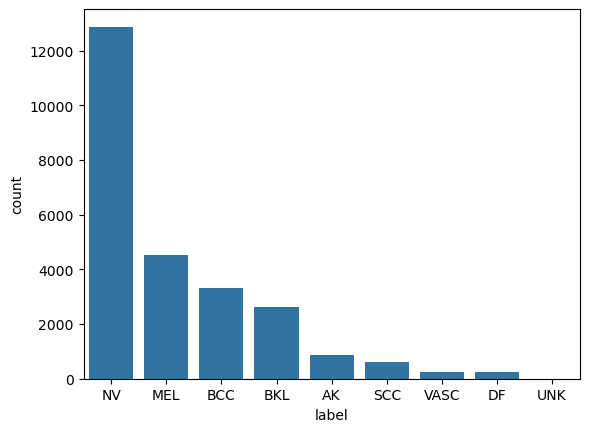

In [8]:
ax = sns.countplot(x="label", data=get_isic_df(), order=['NV', 'MEL', 'BCC', 'BKL', 'AK', 'SCC', 'VASC', 'DF','UNK'])

In [9]:
isic_df = get_isic_df()
label_counts = isic_df['label'].value_counts()
print(label_counts)

label
NV      12875
MEL      4522
BCC      3323
BKL      2624
AK        867
SCC       628
VASC      253
DF        239
Name: count, dtype: int64


In [10]:
isic_df

,name,label
0,content/2019/train/ISIC_0000000.jpg,NV
1,content/2019/train/ISIC_0000001.jpg,NV
2,content/2019/train/ISIC_0000002.jpg,MEL
3,content/2019/train/ISIC_0000003.jpg,NV
4,content/2019/train/ISIC_0000004.jpg,MEL
...,...,...
25326,content/2019/train/ISIC_0073247.jpg,BCC
25327,content/2019/train/ISIC_0073248.jpg,BKL
25328,content/2019/train/ISIC_0073249.jpg,MEL
25329,content/2019/train/ISIC_0073251.jpg,NV


## SD-198

In [11]:
sd198_path = 'content/2019/SD-198'

sd198_isic_classes = {'Actinic_solar_Damage(Actinic_Keratosis)' : 'AK',
                       'Basal_Cell_Carcinoma' : 'BCC',
                       'Dermatofibroma' : 'DF',
                       "Becker's_Nevus" : 'NV',
                       'Blue_Nevus' : 'NV',
                       'Congenital_Nevus' : 'NV',
                       'Benign_Keratosis' : 'BKL', 
                       'Seborrheic_Keratosis' : 'BKL', 
                       'Solar_Lentigo' : 'BKL', 
                       'Lichen_Planus' : 'BKL',
                       'Malignant_Melanoma' : 'MEL', 
                       'Metastatic_Carcinoma' : 'MEL',
                       'Lentigo_Maligna_Melanoma' : 'MEL'}

def get_sd198_df():
    class_dirs = [d for d in os.listdir(f"{sd198_path}/images") if os.path.isdir(f"{sd198_path}/images/{d}")]
    sd198_df = pd.DataFrame()
    non_isic_classes = []

    for c in class_dirs:
        image_files = glob(f"{sd198_path}/images/{c}/*.jpg")
        image_files = [img.replace("\\", "/") for img in image_files]
        df = pd.DataFrame({'name': image_files})
        if c in sd198_isic_classes:
            df['label'] = sd198_isic_classes[c]
        else:
            df['label'] = 'UNK'
            non_isic_classes.append(c)
        sd198_df = pd.concat([sd198_df, df], ignore_index=True)
    
    return sd198_df

In [12]:
get_sd198_df()

,name,label
0,content/2019/SD-198/images/Acne_Keloidalis_Nuc...,UNK
1,content/2019/SD-198/images/Acne_Keloidalis_Nuc...,UNK
2,content/2019/SD-198/images/Acne_Keloidalis_Nuc...,UNK
3,content/2019/SD-198/images/Acne_Keloidalis_Nuc...,UNK
4,content/2019/SD-198/images/Acne_Keloidalis_Nuc...,UNK
...,...,...
6579,content/2019/SD-198/images/Xerosis/030087VB.jpg,UNK
6580,content/2019/SD-198/images/Xerosis/030092HB.jpg,UNK
6581,content/2019/SD-198/images/Xerosis/030100HB.jpg,UNK
6582,content/2019/SD-198/images/Xerosis/030362VB.jpg,UNK


In [13]:
df = get_sd198_df()

# Calculate counts
total_images = len(df)
isic_images = df[df['label'] != 'UNK'].shape[0]
unk_images = df[df['label'] == 'UNK'].shape[0]

# Verify if total - ISIC == UNK
verification = total_images - isic_images == unk_images

# Display the results
print(f"Total images: {total_images}")
print(f"ISIC class images: {isic_images}")
print(f"UNK class images: {unk_images}")
print(f"Does total - ISIC == UNK? {'Yes' if verification else 'No'}")


Total images: 6584
ISIC class images: 640
UNK class images: 5944
Does total - ISIC == UNK? Yes


In [14]:
df['target'] = 0
df['path'] = df['name']
df['diagnosis'] = 'UNK'

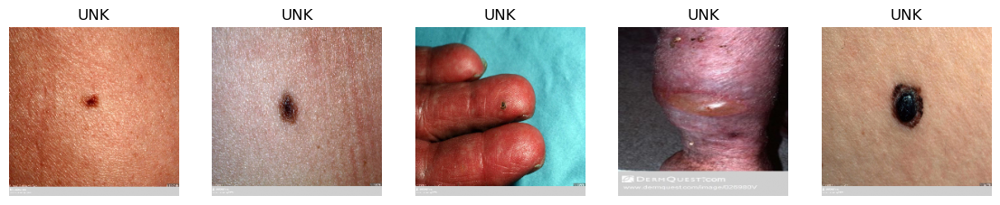

In [15]:
for i in range(1):
  visualize_images(df,i, row_col=(1,5), figsize= (14,14))

## PH2

In [16]:
ph2_path = 'content/2019/PH2/PH2Dataset/'

def get_ph2_df():
    df = pd.read_csv(ph2_path + 'PH2_dataset.txt', sep=r"\|\|", skipfooter=25, engine='python', usecols=[1,3])
    #df = pd.read_csv(ph2_path + 'PH2_dataset.txt', sep="\|\|", skipfooter=25, engine='python', usecols=[1,3])
    df.rename(columns={'   Name ': 'name', ' Clinical Diagnosis ': 'label'}, inplace=True)
    # 0: Common Nevus, 1: Atypical Nevus, 2: Melanoma.
    df.loc[df['label'] == 0, 'label'] = 'NV'
    df.loc[df['label'] == 1, 'label'] = 'NV'
    df.loc[df['label'] == 2, 'label'] = 'MEL'
    df['name'] = df['name'].apply(lambda x: "{0}PH2 Dataset images/{1}/{1}_Dermoscopic_Image/{1}.bmp".format(ph2_path,x.strip()))
    return df

In [17]:
df = get_ph2_df()
df['path'] = df['name']
df['diagnosis'] = df['label']
df['target'] = df['diagnosis']
diagnosis_idx = {d: idx for idx, d in enumerate(sorted(df.diagnosis.unique()))}
df['target'] = df['diagnosis'].map(diagnosis_idx)
df

C:\Users\admin\AppData\Local\Temp\ipykernel_47036\2471324077.py:8: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'NV' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  df.loc[df['label'] == 0, 'label'] = 'NV'


,name,label,path,diagnosis,target
0,content/2019/PH2/PH2Dataset/PH2 Dataset images...,NV,content/2019/PH2/PH2Dataset/PH2 Dataset images...,NV,1
1,content/2019/PH2/PH2Dataset/PH2 Dataset images...,NV,content/2019/PH2/PH2Dataset/PH2 Dataset images...,NV,1
2,content/2019/PH2/PH2Dataset/PH2 Dataset images...,NV,content/2019/PH2/PH2Dataset/PH2 Dataset images...,NV,1
3,content/2019/PH2/PH2Dataset/PH2 Dataset images...,NV,content/2019/PH2/PH2Dataset/PH2 Dataset images...,NV,1
4,content/2019/PH2/PH2Dataset/PH2 Dataset images...,NV,content/2019/PH2/PH2Dataset/PH2 Dataset images...,NV,1
...,...,...,...,...,...
195,content/2019/PH2/PH2Dataset/PH2 Dataset images...,MEL,content/2019/PH2/PH2Dataset/PH2 Dataset images...,MEL,0
196,content/2019/PH2/PH2Dataset/PH2 Dataset images...,MEL,content/2019/PH2/PH2Dataset/PH2 Dataset images...,MEL,0
197,content/2019/PH2/PH2Dataset/PH2 Dataset images...,MEL,content/2019/PH2/PH2Dataset/PH2 Dataset images...,MEL,0
198,content/2019/PH2/PH2Dataset/PH2 Dataset images...,MEL,content/2019/PH2/PH2Dataset/PH2 Dataset images...,MEL,0


In [18]:
df.label.value_counts()

label
NV     160
MEL     40
Name: count, dtype: int64

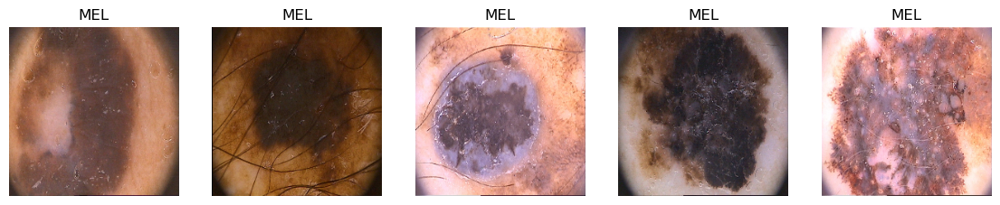

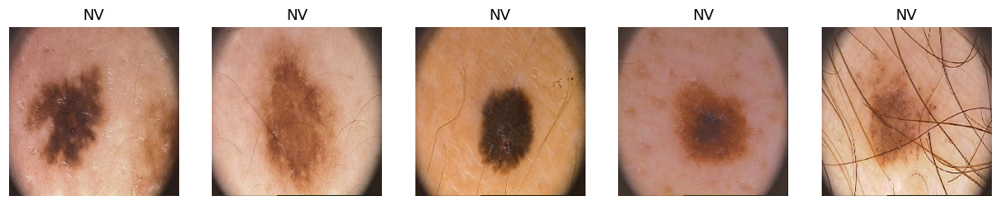

<Figure size 1400x1400 with 0 Axes>

<Figure size 1400x1400 with 0 Axes>

In [19]:
for i in range(4):
  visualize_images(df,i, row_col=(1,5), figsize= (14,14))

In [20]:
pd.set_option("display.max_colwidth", None)
print(df["name"])

0      content/2019/PH2/PH2Dataset/PH2 Dataset images/IMD003/IMD003_Dermoscopic_Image/IMD003.bmp
1      content/2019/PH2/PH2Dataset/PH2 Dataset images/IMD009/IMD009_Dermoscopic_Image/IMD009.bmp
2      content/2019/PH2/PH2Dataset/PH2 Dataset images/IMD016/IMD016_Dermoscopic_Image/IMD016.bmp
3      content/2019/PH2/PH2Dataset/PH2 Dataset images/IMD022/IMD022_Dermoscopic_Image/IMD022.bmp
4      content/2019/PH2/PH2Dataset/PH2 Dataset images/IMD024/IMD024_Dermoscopic_Image/IMD024.bmp
                                                 ...                                            
195    content/2019/PH2/PH2Dataset/PH2 Dataset images/IMD424/IMD424_Dermoscopic_Image/IMD424.bmp
196    content/2019/PH2/PH2Dataset/PH2 Dataset images/IMD425/IMD425_Dermoscopic_Image/IMD425.bmp
197    content/2019/PH2/PH2Dataset/PH2 Dataset images/IMD426/IMD426_Dermoscopic_Image/IMD426.bmp
198    content/2019/PH2/PH2Dataset/PH2 Dataset images/IMD429/IMD429_Dermoscopic_Image/IMD429.bmp
199    content/2019/PH2/PH2Dat

## 7-point

In [21]:
derm7pt_path = 'content/2019/7-point/'
def get_df_7point():
    '''
    Credits: 
    https://github.com/j05t/lesion-analysis/blob/master/isic_classifier_se_resnext101_32x4d.ipynb
    '''
    df = pd.read_csv('content/2019/7-point/meta.csv', usecols=['derm', 'diagnosis'])
    df.rename(columns={'derm': 'name', 'diagnosis': 'label'}, inplace=True)
    
    df.loc[df['label'] == 'basal cell carcinoma', 'label'] = 'BCC'
    df.loc[df['label'] == 'lentigo', 'label'] = 'BKL'
    df.loc[df['label'] == 'seborrheic keratosis', 'label'] = 'BKL'
    df.loc[df['label'] == 'dermatofibroma', 'label'] = 'DF'
    df.loc[df['label'] == 'vascular lesion', 'label'] = 'VASC'
    # https://meshb.nlm.nih.gov/record/ui?ui=D008548
    df.loc[df['label'] == 'melanosis', 'label'] = 'BKL'
    # classified as benign melanocytic lesion
    # https://www.ncbi.nlm.nih.gov/pmc/articles/PMC4866625/
    df.loc[df['label'] == 'reed or spitz nevus', 'label'] = 'NV'
    # Melanocytic nevus
    df.loc[df['label'] == 'blue nevus', 'label'] = 'NV'
    df.loc[df['label'] == 'clark nevus', 'label'] = 'NV'
    df.loc[df['label'] == 'combined nevus', 'label'] = 'NV'
    df.loc[df['label'] == 'congenital nevus', 'label'] = 'NV'
    df.loc[df['label'] == 'dermal nevus', 'label'] = 'NV'
    df.loc[df['label'] == 'melanoma', 'label'] = 'MEL'
    df.loc[df['label'] == 'melanoma metastasis', 'label'] = 'MEL'
    df.loc[df['label'] == 'melanoma (in situ)', 'label'] = 'MEL'
    df.loc[df['label'] == 'melanoma (less than 0.76 mm)', 'label'] = 'MEL'
    df.loc[df['label'] == 'melanoma (0.76 to 1.5 mm)', 'label'] = 'MEL'
    df.loc[df['label'] == 'melanoma (more than 1.5 mm)', 'label'] = 'MEL'
    # none of the others
    df.loc[df['label'] == 'miscellaneous', 'label'] = 'UNK'
    df.loc[df['label'] == 'recurrent nevus', 'label'] = 'UNK'
    
    df = df[['name', 'label']]
   
    df['name'] = df['name'].apply(lambda x: "{}images/{}".format(derm7pt_path,x))
    return df

In [22]:
get_df_7point()

,name,label
0,content/2019/7-point/images/NEL/Nel026.jpg,BCC
1,content/2019/7-point/images/NEL/Nel028.jpg,BCC
2,content/2019/7-point/images/NEL/Nel033.jpg,BCC
3,content/2019/7-point/images/NEL/Nel035.jpg,BCC
4,content/2019/7-point/images/NEL/Nel037.jpg,BCC
...,...,...
1006,content/2019/7-point/images/Fhl/Fhl058.jpg,VASC
1007,content/2019/7-point/images/Fhl/Fhl060.jpg,VASC
1008,content/2019/7-point/images/Fil/Fil082.jpg,VASC
1009,content/2019/7-point/images/New/newl016.jpg,VASC


label
NV      569
MEL     252
BKL      85
BCC      42
VASC     29
DF       20
UNK      14
Name: count, dtype: int64


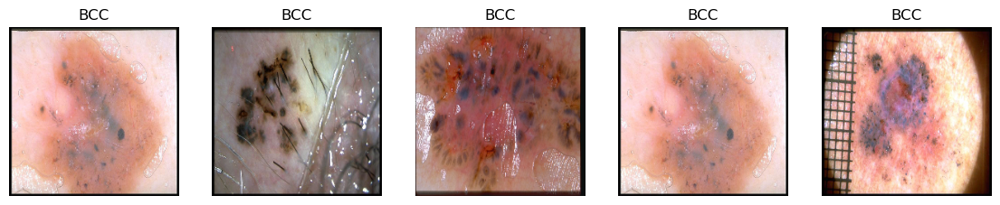

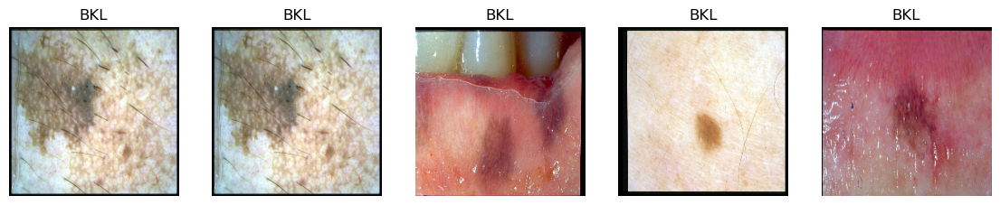

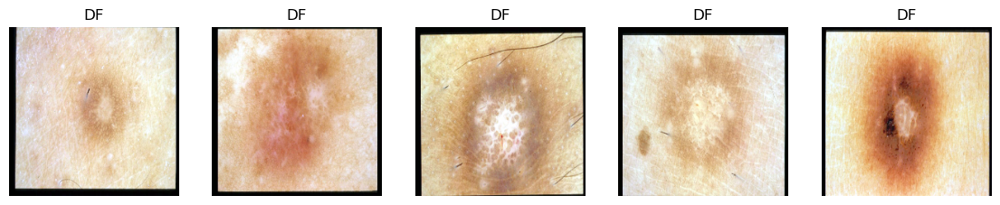

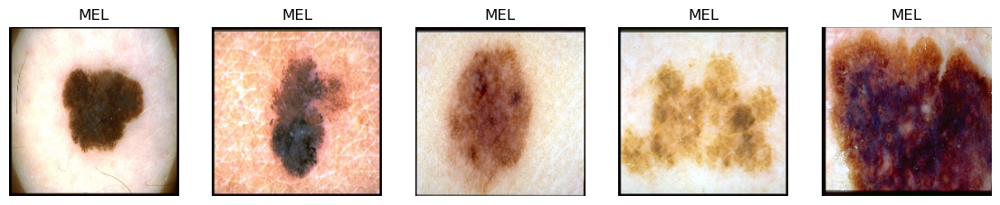

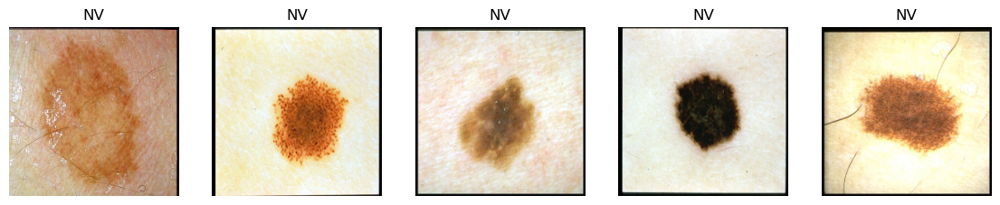

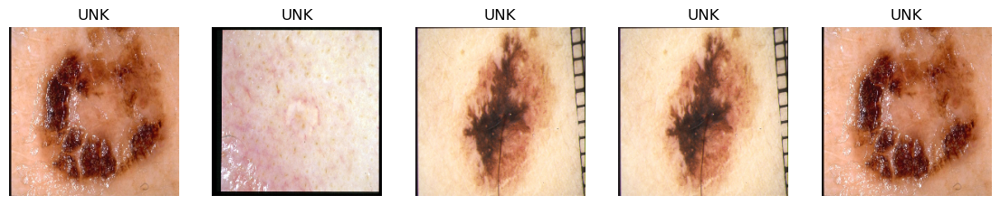

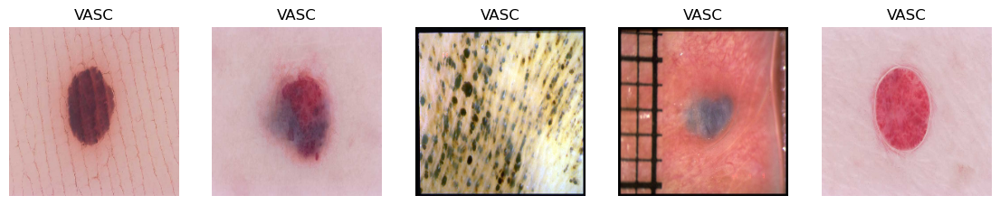

<Figure size 1400x1400 with 0 Axes>

<Figure size 1400x1400 with 0 Axes>

<Figure size 1400x1400 with 0 Axes>

In [23]:
df = get_df_7point()
df['path'] = df['name']
df['diagnosis'] = df['label']
df['target'] = df['diagnosis']
diagnosis_idx = {d: idx for idx, d in enumerate(sorted(df.diagnosis.unique()))}
df['target'] = df['diagnosis'].map(diagnosis_idx)

print(df.label.value_counts())
for i in range(10):
  visualize_images(df,i, row_col=(1,5), figsize= (14,14))

In [72]:
# import os
# import shutil

# dir = "1959_6x6/"

# for file in os.listdir(dir):
#     # get all but the last 8 characters to remove
#     # the index number and extension
#     dir_name = file[-8]
#     print(f'dir_name: {dir_name}')

#     dir_path = dir + dir_name
#     print(f'dir_path: {dir_path}')
    
#     # check if directory exists or not yet
#     if not os.path.exists(dir_path):
#         os.makedirs(dir_path)

#     if os.path.exists(dir_path):
#         file_path = dir + file
#         print(f'file_path: {file_path}')
        
#         # move files into created directory
#         shutil.move(file_path, dir_path)

In [73]:
# handle_images = get_df_7point()['tmp'].str.split('/', n=1, expand=True)
# handle_images[0].value_counts().index

In [74]:
# import os
# import shutil
# path = '/content/drive/MyDrive/ISIC/2019/7-point/data/'
# path2 = '/content/drive/MyDrive/ISIC/2019/7-point/images/'
# for i, file in enumerate(handle_images[0]):
#   # check if directory exists or not yet
#   # if not os.path.exists(path+file):
#   #   print("im here?")
#   #   os.makedirs(path+file)

#   dir_path=path+handle_images[1][i]
#   print(f'dir_path: {dir_path}')
#   if os.path.exists(path2+file):
#     file_path = path2+file
#     print(f'file_path: {file_path}')

#     # move files into created directory
#     shutil.move(dir_path, file_path)

## MED-NODE

In [24]:
import os
import pandas as pd

mednode_path = 'content/2019/med-node/'

def get_mednode_df():
    mel = [os.path.join(mednode_path, 'melanoma', f) for f in os.listdir(os.path.join(mednode_path, 'melanoma')) if f.endswith('.jpg')]
    nv = [os.path.join(mednode_path, 'naevus', f) for f in os.listdir(os.path.join(mednode_path, 'naevus')) if f.endswith('.jpg')]

    # Force forward slashes
    mel = [img.replace("\\", "/") for img in mel]
    nv = [img.replace("\\", "/") for img in nv]

    mel_df = pd.DataFrame(mel, columns=['name'])
    nv_df = pd.DataFrame(nv, columns=['name'])

    mel_df['label'] = 'MEL'
    nv_df['label'] = 'NV'

    df = pd.concat([mel_df, nv_df], ignore_index=True)

    return df

In [25]:
df = get_mednode_df()
df

,name,label
0,content/2019/med-node/melanoma/136733.jpg,MEL
1,content/2019/med-node/melanoma/154372.jpg,MEL
2,content/2019/med-node/melanoma/16175.jpg,MEL
3,content/2019/med-node/melanoma/1651872.jpg,MEL
4,content/2019/med-node/melanoma/1657793.jpg,MEL
...,...,...
165,content/2019/med-node/naevus/458192.jpg,NV
166,content/2019/med-node/naevus/497621.jpg,NV
167,content/2019/med-node/naevus/499701.jpg,NV
168,content/2019/med-node/naevus/515125.jpg,NV


label
NV     100
MEL     70
Name: count, dtype: int64


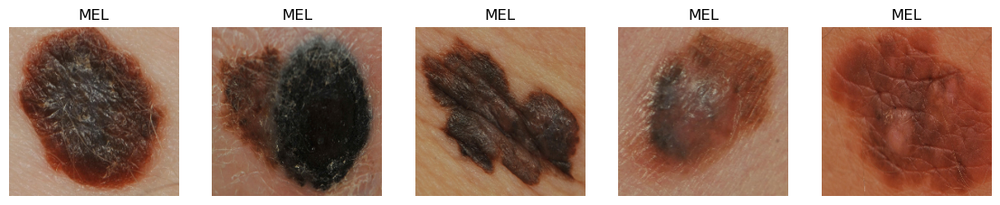

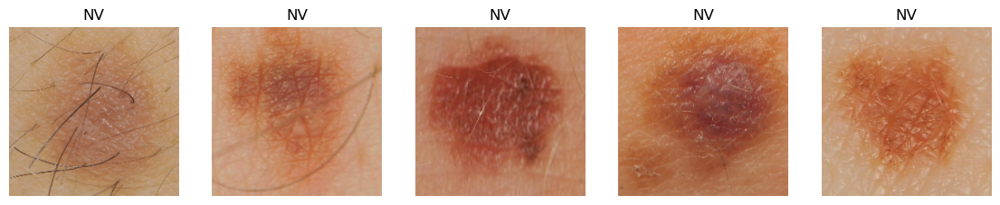

<Figure size 1400x1400 with 0 Axes>

<Figure size 1400x1400 with 0 Axes>

<Figure size 1400x1400 with 0 Axes>

<Figure size 1400x1400 with 0 Axes>

<Figure size 1400x1400 with 0 Axes>

<Figure size 1400x1400 with 0 Axes>

<Figure size 1400x1400 with 0 Axes>

<Figure size 1400x1400 with 0 Axes>

In [77]:
df['path'] = df['name']
df['diagnosis'] = df['label']
df['target'] = df['diagnosis']
diagnosis_idx = {d: idx for idx, d in enumerate(sorted(df.diagnosis.unique()))}
df['target'] = df['diagnosis'].map(diagnosis_idx)

print(df.label.value_counts())
for i in range(10):
  visualize_images(df,i, row_col=(1,5), figsize= (14,14))

## Get dataset

In [26]:
use_external_data = True

In [27]:
def get_external_df():
    return pd.concat([get_sd198_df(), get_ph2_df(), get_df_7point(), get_mednode_df()], sort=False)

In [28]:
data_df = pd.concat([get_external_df(), get_isic_df()], sort=False) if use_external_data else get_isic_df()

C:\Users\admin\AppData\Local\Temp\ipykernel_47036\2471324077.py:8: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'NV' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  df.loc[df['label'] == 0, 'label'] = 'NV'


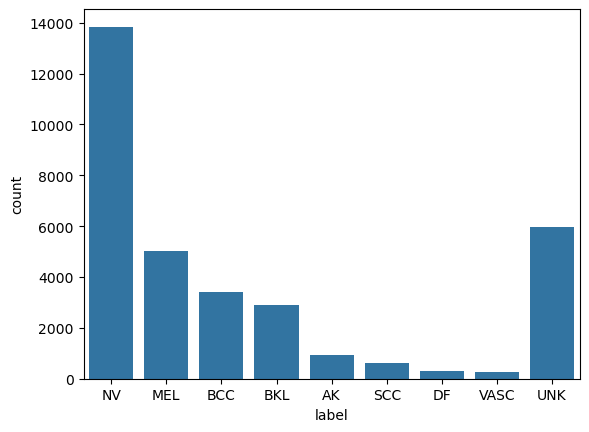

In [29]:
ax = sns.countplot(x="label", data=data_df, order=['NV', 'MEL', 'BCC', 'BKL', 'AK', 'SCC', 'DF', 'VASC', 'UNK'])

In [30]:
label_counts = data_df['label'].value_counts()
print(label_counts)
print(data_df.shape)

label
NV      13841
UNK      5958
MEL      5024
BCC      3425
BKL      2892
AK        927
SCC       628
DF        319
VASC      282
Name: count, dtype: int64
(33296, 2)


In [31]:
data_df

,name,label
0,content/2019/SD-198/images/Acne_Keloidalis_Nuchae/009514HB.jpg,UNK
1,content/2019/SD-198/images/Acne_Keloidalis_Nuchae/009514HB1.jpg,UNK
2,content/2019/SD-198/images/Acne_Keloidalis_Nuchae/009881HB.jpg,UNK
3,content/2019/SD-198/images/Acne_Keloidalis_Nuchae/009888HB.jpg,UNK
4,content/2019/SD-198/images/Acne_Keloidalis_Nuchae/009889HB.jpg,UNK
...,...,...
25326,content/2019/train/ISIC_0073247.jpg,BCC
25327,content/2019/train/ISIC_0073248.jpg,BKL
25328,content/2019/train/ISIC_0073249.jpg,MEL
25329,content/2019/train/ISIC_0073251.jpg,NV


## ISIC 2019

In [32]:
import pandas as pd
import os

import numpy as np
from sklearn.model_selection import train_test_split

def to_path(image_name, path):
  return path + image_name + '.jpg'

def create_target(df):
  df['target'] = df['diagnosis']
  diagnosis_idx = {d: idx for idx, d in enumerate(sorted(df.diagnosis.unique()))}
  df['target'] = df['diagnosis'].map(diagnosis_idx)
  return df

def mapping(df, date):
  if date == '2019':
    df['diagnosis'] = None
    df['diagnosis'].mask(df['MEL']==1, 'MEL', inplace=True)
    df['diagnosis'].mask(df['NV']==1, 'NV', inplace=True)
    df['diagnosis'].mask(df['BCC']==1, 'BCC', inplace=True)
    df['diagnosis'].mask(df['AK']==1, 'AK', inplace=True)
    df['diagnosis'].mask(df['BKL']==1, 'BKL', inplace=True)
    df['diagnosis'].mask(df['DF']==1, 'DF', inplace=True)
    df['diagnosis'].mask(df['VASC']==1, 'VASC', inplace=True)
    df['diagnosis'].mask(df['SCC']==1, 'SCC', inplace=True)
    df['diagnosis'].mask(df['UNK']==1, 'UNK', inplace=True)
  if date == '2020':
    df['diagnosis'] = df['diagnosis'].apply(lambda x: x.replace('seborrheic keratosis', 'BKL'))
    df['diagnosis'] = df['diagnosis'].apply(lambda x: x.replace('lichenoid keratosis', 'BKL'))
    df['diagnosis'] = df['diagnosis'].apply(lambda x: x.replace('solar lentigo', 'BKL'))
    df['diagnosis'] = df['diagnosis'].apply(lambda x: x.replace('lentigo NOS', 'BKL'))
    df['diagnosis'] = df['diagnosis'].apply(lambda x: x.replace('cafe-au-lait macule', 'UNK'))
    df['diagnosis'] = df['diagnosis'].apply(lambda x: x.replace('atypical melanocytic proliferation', 'UNK'))
    df['diagnosis'] = df['diagnosis'].apply(lambda x: x.replace('unknown', 'UNK'))
    df['diagnosis'] = df['diagnosis'].apply(lambda x: x.replace('nevus', 'NV'))
    df['diagnosis'] = df['diagnosis'].apply(lambda x: x.replace('melanoma', 'MEL'))

  return df

def create_df(dir, file_name, val_size= 0.25, export_csv=False, subset = False, whole = False, external_data=False, date='2019'):
  '''
  Creates a dataframe with the following assertions
  file_name: name of the csv file (if name is 'test' only a path is added)
  export_csv: export dataframe
  whole: return the whole dataset the path and mapping
  subset: return a subset of the dataset with path and mapping
  '''
  df = pd.read_csv(f'{dir}/{file_name}.csv')
  if date == '2020':
    df = df.rename(columns={"image_name":"image"})
  df['path'] = df.image.apply(to_path, path = f'{dir}/{file_name}/')  

  if file_name == 'test':
    if export_csv:
      df.to_csv(f'{dir}/{file_name}.csv', index=False)
    return df.reset_index(drop=True)

  mapping(df, date)
  if external_data:
    ext = get_external_df()
    ext['diagnosis'] = ext['label']
    ext['path'] = ext['name']
    ext = ext.drop(columns='label')
    ext = ext.drop(columns='name')
    if whole:
      ext = create_target(ext)
      if export_csv:
        ext.to_csv(f'{dir}/{file_name}_whole_ext.csv', index=False)
      return ext.reset_index(drop=True)
    else:
      ext = pd.concat([df, ext], sort=False)
      # ext = create_target(ext)
      df, df_val = train_test_split(ext, random_state=42, test_size=val_size, shuffle=True, stratify=ext['target'])
      if export_csv:
        df.to_csv(f'{dir}/train_ext.csv', index=False)
        df_val.to_csv(f'{dir}/val_ext.csv', index=False)
    return df.reset_index(drop=True), df_val.reset_index(drop=True)
  
  df = create_target(df)
  if whole:
    if export_csv:
      df.to_csv(f'{dir}/{file_name}_whole.csv', index=False)
    return df.reset_index(drop=True)
  
  df, df_val = train_test_split(df, random_state=42, test_size=val_size, shuffle=True, stratify=df['target'])
  if subset:
    subset_, subset_val = train_test_split(df, random_state=42, test_size=0.33, shuffle=True, stratify=df['target'])
    if export_csv:
      df.to_csv(f'{dir}/subset.csv', index=False)
    return subset_.reset_index(drop=True), subset_val.reset_index(drop=True)
  if export_csv:
    df.to_csv(f'{dir}/train_split.csv', index=False)
    df_val.to_csv(f'{dir}/val_split.csv', index=False)
  return df.reset_index(drop=True), df_val.reset_index(drop=True)

Credits: 
https://github.com/j05t/lesion-analysis/blob/master/isic_classifier_se_resnext101_32x4d.ipynb

## Dataset 2020

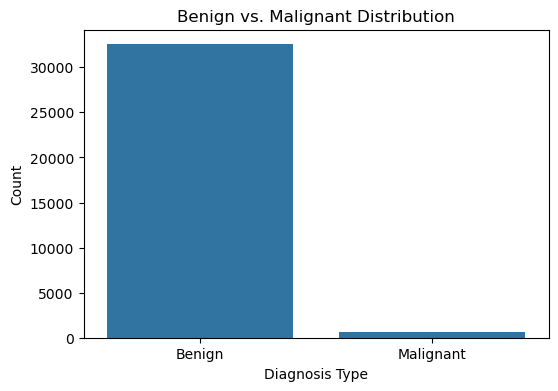

label
Benign       32542
Malignant      584
Name: count, dtype: int64


,name,label
0,content/2020/train/ISIC_2637011.jpg,Benign
1,content/2020/train/ISIC_0015719.jpg,Benign
2,content/2020/train/ISIC_0052212.jpg,Benign
3,content/2020/train/ISIC_0068279.jpg,Benign
4,content/2020/train/ISIC_0074268.jpg,Benign
...,...,...
33121,content/2020/train/ISIC_9999134.jpg,Benign
33122,content/2020/train/ISIC_9999320.jpg,Benign
33123,content/2020/train/ISIC_9999515.jpg,Benign
33124,content/2020/train/ISIC_9999666.jpg,Benign


In [34]:
import os
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

isic_2020_path = 'content/2020/train'

def get_isic2020_df():
    df = pd.read_csv('content/2020/train.csv')
    df['label'] = df['target'].apply(lambda x: 'Malignant' if x == 1 else 'Benign')
    df.rename(columns={'image_name': 'name'}, inplace=True)
    df['name'] = df['name'].apply(lambda x: f"{isic_2020_path}/{x}.jpg")
    df = df[['name', 'label']]

    return df

isic_2020_df = get_isic2020_df()

plt.figure(figsize=(6,4))
ax = sns.countplot(x="label", data=isic_2020_df, order=['Benign', 'Malignant'])
plt.title("Benign vs. Malignant Distribution")
plt.xlabel("Diagnosis Type")
plt.ylabel("Count")
plt.show()

label_counts = isic_2020_df['label'].value_counts()
print(label_counts)

isic_2020_df


## Get test data

In [35]:
isic_test_path = 'content/2019/test/ISIC_2019_Test_Input'

In [36]:
def get_isic_test_df():
    df = pd.read_csv('content/2019/test/ISIC_2019_Test_Metadata.csv', usecols=['image'])
    path_test_img = 'ISIC_2019_Test_Input'
    df.rename(columns={'image': 'name'}, inplace=True)
    return df

In [37]:
get_isic_test_df()

,name
0,ISIC_0034321
1,ISIC_0034322
2,ISIC_0034323
3,ISIC_0034324
4,ISIC_0034325
...,...
8233,ISIC_0073236
8234,ISIC_0073243
8235,ISIC_0073250
8236,ISIC_0073252


In [38]:
import pandas as pd
test_csv = r"content/2019/test/ISIC_2019_Test_Metadata.csv"
test = pd.read_csv(test_csv)
test.shape

(8238, 4)

In [39]:
import pandas as pd
test_csv = r"content/2019/test/ISIC_2019_Test_GroundTruth.csv"
test = pd.read_csv(test_csv)
test.shape

(8238, 12)

# Create datasets

In [41]:
df_2019 = create_df(dir= 'content/2019', file_name='train', whole=True, date='2019')
df_2019

C:\Users\admin\AppData\Local\Temp\ipykernel_47036\3794397437.py:19: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['diagnosis'].mask(df['MEL']==1, 'MEL', inplace=True)
C:\Users\admin\AppData\Local\Temp\ipykernel_47036\3794397437.py:20: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

,image,MEL,NV,BCC,AK,BKL,DF,VASC,SCC,UNK,path,diagnosis,target
0,ISIC_0000000,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,content/2019/train/ISIC_0000000.jpg,NV,5
1,ISIC_0000001,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,content/2019/train/ISIC_0000001.jpg,NV,5
2,ISIC_0000002,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,content/2019/train/ISIC_0000002.jpg,MEL,4
3,ISIC_0000003,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,content/2019/train/ISIC_0000003.jpg,NV,5
4,ISIC_0000004,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,content/2019/train/ISIC_0000004.jpg,MEL,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
25326,ISIC_0073247,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,content/2019/train/ISIC_0073247.jpg,BCC,1
25327,ISIC_0073248,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,content/2019/train/ISIC_0073248.jpg,BKL,2
25328,ISIC_0073249,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,content/2019/train/ISIC_0073249.jpg,MEL,4
25329,ISIC_0073251,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,content/2019/train/ISIC_0073251.jpg,NV,5


In [42]:
print(df_2019['diagnosis'].shape[0])

25331


In [43]:
df_2019.drop(df_2019.columns.difference(['image','path','diagnosis']), axis=1, inplace=True)

In [44]:
df_2019

,image,path,diagnosis
0,ISIC_0000000,content/2019/train/ISIC_0000000.jpg,NV
1,ISIC_0000001,content/2019/train/ISIC_0000001.jpg,NV
2,ISIC_0000002,content/2019/train/ISIC_0000002.jpg,MEL
3,ISIC_0000003,content/2019/train/ISIC_0000003.jpg,NV
4,ISIC_0000004,content/2019/train/ISIC_0000004.jpg,MEL
...,...,...,...
25326,ISIC_0073247,content/2019/train/ISIC_0073247.jpg,BCC
25327,ISIC_0073248,content/2019/train/ISIC_0073248.jpg,BKL
25328,ISIC_0073249,content/2019/train/ISIC_0073249.jpg,MEL
25329,ISIC_0073251,content/2019/train/ISIC_0073251.jpg,NV


In [47]:
df_meta_2019 = pd.read_csv(f'content/2019/ISIC_2019_Training_Metadata.csv').reset_index(drop=True)
df_meta_2019

,image,age_approx,anatom_site_general,lesion_id,sex
0,ISIC_0000000,55.0,anterior torso,NaN,female
1,ISIC_0000001,30.0,anterior torso,NaN,female
2,ISIC_0000002,60.0,upper extremity,NaN,female
3,ISIC_0000003,30.0,upper extremity,NaN,male
4,ISIC_0000004,80.0,posterior torso,NaN,male
...,...,...,...,...,...
25326,ISIC_0073247,85.0,head/neck,BCN_0003925,female
25327,ISIC_0073248,65.0,anterior torso,BCN_0001819,male
25328,ISIC_0073249,70.0,lower extremity,BCN_0001085,male
25329,ISIC_0073251,55.0,palms/soles,BCN_0002083,female


In [48]:
df_meta_2019.drop(columns={'image','lesion_id'}, axis=1, inplace=True)

In [49]:
df_meta_2019

,age_approx,anatom_site_general,sex
0,55.0,anterior torso,female
1,30.0,anterior torso,female
2,60.0,upper extremity,female
3,30.0,upper extremity,male
4,80.0,posterior torso,male
...,...,...,...
25326,85.0,head/neck,female
25327,65.0,anterior torso,male
25328,70.0,lower extremity,male
25329,55.0,palms/soles,female


In [50]:
df_2019 = pd.concat([df_2019, df_meta_2019], sort=False, axis=1)
df_2019
df_2019['diagnosis'].value_counts()

diagnosis
NV      12875
MEL      4522
BCC      3323
BKL      2624
AK        867
SCC       628
VASC      253
DF        239
Name: count, dtype: int64

In [51]:
df_2020 = create_df(dir=r'content/2020', file_name='train', whole = True, date='2020')
df_2020.rename(columns={"anatom_site_general_challenge": "anatom_site_general"}, inplace=True)
df_2020.drop(columns={'target','benign_malignant','patient_id'}, axis=1, inplace=True)
print(df_2020['diagnosis'].shape[0])
df_2020['diagnosis'].value_counts()

33126


diagnosis
UNK    27126
NV      5193
MEL      584
BKL      223
Name: count, dtype: int64

In [52]:
df_2020

,image,sex,age_approx,anatom_site_general,diagnosis,path
0,ISIC_2637011,male,45.0,head/neck,UNK,content/2020/train/ISIC_2637011.jpg
1,ISIC_0015719,female,45.0,upper extremity,UNK,content/2020/train/ISIC_0015719.jpg
2,ISIC_0052212,female,50.0,lower extremity,NV,content/2020/train/ISIC_0052212.jpg
3,ISIC_0068279,female,45.0,head/neck,UNK,content/2020/train/ISIC_0068279.jpg
4,ISIC_0074268,female,55.0,upper extremity,UNK,content/2020/train/ISIC_0074268.jpg
...,...,...,...,...,...,...
33121,ISIC_9999134,male,50.0,torso,UNK,content/2020/train/ISIC_9999134.jpg
33122,ISIC_9999320,male,65.0,torso,UNK,content/2020/train/ISIC_9999320.jpg
33123,ISIC_9999515,male,20.0,lower extremity,UNK,content/2020/train/ISIC_9999515.jpg
33124,ISIC_9999666,male,50.0,lower extremity,UNK,content/2020/train/ISIC_9999666.jpg


In [54]:
df_2019_2020 = pd.concat([df_2019, df_2020], sort=False)
df_2019_2020.anatom_site_general.value_counts()

anatom_site_general
torso              16845
lower extremity    13407
upper extremity     7893
anterior torso      6915
head/neck           6442
posterior torso     2787
palms/soles          773
oral/genital         183
lateral torso         54
Name: count, dtype: int64

In [55]:
derm7pt_path = 'content/2019/7-point'
t=None
df = pd.read_csv('content/2019/7-point/meta.csv')

if 'age_approx' not in df.columns:
  df['age_approx'] = 0

if 'location' in df.columns:
  df.rename(columns={"location": "anatom_site_general"}, inplace=True)
  df['anatom_site_general'] = df['anatom_site_general'].apply(lambda x: x.replace('chest', 'torso'))
  df['anatom_site_general'] = df['anatom_site_general'].apply(lambda x: x.replace('back', 'posterior torso'))
  df['anatom_site_general'] = df['anatom_site_general'].apply(lambda x: x.replace('lower limbs', 'lower extremity'))
  df['anatom_site_general'] = df['anatom_site_general'].apply(lambda x: x.replace('abdomen', 'anterior torso'))
  df['anatom_site_general'] = df['anatom_site_general'].apply(lambda x: x.replace('upper limbs', 'upper extremity'))
  df['anatom_site_general'] = df['anatom_site_general'].apply(lambda x: x.replace('head neck', 'head/neck'))
  df['anatom_site_general'] = df['anatom_site_general'].apply(lambda x: x.replace('buttocks', 'unknown'))
  df['anatom_site_general'] = df['anatom_site_general'].apply(lambda x: x.replace('acral', 'upper extremity'))
  df['anatom_site_general'] = df['anatom_site_general'].apply(lambda x: x.replace('genital areas', 'oral/genital'))
df.anatom_site_general.value_counts()

anatom_site_general
posterior torso    281
lower extremity    200
upper extremity    184
anterior torso     125
torso              100
head/neck           92
unknown             21
oral/genital         8
Name: count, dtype: int64

In [57]:
ext = create_df(dir='content/2019', file_name='train', whole = True, external_data=True)
print(ext['diagnosis'].shape[0])
ext['diagnosis'].value_counts()

7965


C:\Users\admin\AppData\Local\Temp\ipykernel_47036\3794397437.py:19: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['diagnosis'].mask(df['MEL']==1, 'MEL', inplace=True)
C:\Users\admin\AppData\Local\Temp\ipykernel_47036\3794397437.py:20: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

diagnosis
UNK     5958
NV       966
MEL      502
BKL      268
BCC      102
DF        80
AK        60
VASC      29
Name: count, dtype: int64

In [58]:
df_ = df_2019_2020

In [60]:
df__ = pd.concat([df_, ext], sort=False)
df__ = create_target(df__)
print(df__.diagnosis.shape[0])
df__.diagnosis.value_counts()
df__.to_csv(f'results/whole_data.csv', index=False)

66422


In [62]:
df_ = pd.read_csv(f'results/whole_data.csv').reset_index(drop=True)
print(df_['diagnosis'].value_counts())
df, df_val = train_test_split(df_, random_state=42, test_size=0.125, shuffle=True, stratify=df_['target'])
df.to_csv(f'results/train_whole.csv', index=False)
df_val.to_csv(f'results/val_whole.csv', index=False)
print(df.shape, df_val.shape)
df = None
df_val = None

diagnosis
UNK     33084
NV      19034
MEL      5608
BCC      3425
BKL      3115
AK        927
SCC       628
DF        319
VASC      282
Name: count, dtype: int64
(58119, 7) (8303, 7)


In [63]:
print(df_)  # To check if df_ is initialized properly
print(df_.columns)  # To verify if there is an 'image' column

              image                                       path diagnosis  \
0      ISIC_0000000        content/2019/train/ISIC_0000000.jpg        NV   
1      ISIC_0000001        content/2019/train/ISIC_0000001.jpg        NV   
2      ISIC_0000002        content/2019/train/ISIC_0000002.jpg       MEL   
3      ISIC_0000003        content/2019/train/ISIC_0000003.jpg        NV   
4      ISIC_0000004        content/2019/train/ISIC_0000004.jpg       MEL   
...             ...                                        ...       ...   
66417           NaN    content/2019/med-node/naevus/458192.jpg        NV   
66418           NaN    content/2019/med-node/naevus/497621.jpg        NV   
66419           NaN    content/2019/med-node/naevus/499701.jpg        NV   
66420           NaN    content/2019/med-node/naevus/515125.jpg        NV   
66421           NaN  content/2019/med-node/naevus/587862-h.jpg        NV   

       age_approx anatom_site_general     sex  target  
0            55.0      anterior

In [63]:
duplicates = pd.read_csv(f'results/duplicates_whole_filenames.csv').reset_index(drop=True)
df_['temporal_image'] = df_.image[df_.image.notnull()] + '.jpg'
df_ = df_[~df_.temporal_image.isin(duplicates.image_pair)]
df_.shape

(65264, 8)

In [65]:
df_unk = df__[df__['diagnosis'] == 'UNK']  # Assuming 'UNK' is a possible label
df_unk.to_csv("results/whole_data_unk.csv", index=False)

print("CSV files created successfully!")

CSV files created successfully!


In [66]:
df_ = pd.read_csv(f'results/whole_data_unk.csv').reset_index(drop=True)
print(df_['diagnosis'].value_counts())
df, df_val = train_test_split(df_, random_state=42, test_size=0.125, shuffle=True, stratify=df_['target'])
df.to_csv(f'results/train_whole_unk.csv', index=False)
df_val.to_csv(f'results/val_whole_unk.csv', index=False)
print(df.shape, df_val.shape)
df = None
df_val = None

diagnosis
UNK    33084
Name: count, dtype: int64
(28948, 7) (4136, 7)


# Identify Duplicates

Competitor host admits there [true duplicates](https://www.kaggle.com/competitions/siim-isic-melanoma-classification/discussion/161943) on 2020 dataset. Since the new is composed of 2019+2020, identifying duplicates is a must to avoid leaks on validation data, more importantly when performing cross.

### imagededup

In [67]:
import torch
import pandas as pd

In [68]:
torch.cuda.is_available()

True

In [69]:
from imagededup.methods import PHash

phasher = PHash()

encodings = phasher.encode_images(image_dir=r'D:\FINAL_PROJECT\data')
duplicates = phasher.find_duplicates(encoding_map=encodings, max_distance_threshold=0)

2025-02-14 18:19:38,707: INFO Start: Calculating hashes...
100%|████████████████████████████████████████████████████████████████████████████| 58459/58459 [17:10<00:00, 56.73it/s]
2025-02-14 18:36:54,347: INFO End: Calculating hashes!
D:\FINAL_PROJECT\conda_files\envs\pjt\Lib\site-packages\imagededup\methods\hashing.py:317: RuntimeWarning: Parameter num_enc_workers has no effect since encodings are already provided
  warnings.warn('Parameter num_enc_workers has no effect since encodings are already provided', RuntimeWarning)
2025-02-14 18:36:54,399: INFO Start: Evaluating hamming distances for getting duplicates
2025-02-14 18:36:54,400: INFO Start: Retrieving duplicates using BKTree algorithm
100%|███████████████████████████████████████████████████████████████████████████| 58457/58457 [02:33<00:00, 381.08it/s]
2025-02-14 18:39:33,631: INFO End: Retrieving duplicates using BKTree algorithm
2025-02-14 18:39:33,638: INFO End: Evaluating hamming distances for getting duplicates


In [70]:
t = []
for e in duplicates.items():
  if e[1]:
    l = e[0],e[1]
    t.append(l)
  else:
    pass

In [72]:
df = pd.DataFrame(t, columns=['image_id','image_pair'])
df.to_csv('results/duplicates_whole.csv', index=False)

# Load duplicates

In [73]:
df = pd.read_csv('results/duplicates_whole.csv')
df.shape

(1165, 2)

In [74]:
df.shape

(1165, 2)

In [75]:
df

,image_id,image_pair
0,ISIC_0000206_downsampled.jpg,['ISIC_0014739_downsampled.jpg']
1,ISIC_0000222.jpg,['ISIC_0014846_downsampled.jpg']
2,ISIC_0000519_downsampled.jpg,['ISIC_0011295.jpg']
3,ISIC_0011295.jpg,['ISIC_0000519_downsampled.jpg']
4,ISIC_0012127_downsampled.jpg,['ISIC_0012970_downsampled.jpg']
...,...,...
1160,ISIC_9917477.jpg,['ISIC_2636012.jpg']
1161,ISIC_9933282.jpg,['ISIC_1979109.jpg']
1162,ISIC_9952408.jpg,['ISIC_5607452.jpg']
1163,ISIC_9967383.jpg,['ISIC_2607827.jpg']


### view 1

In [76]:
import cv2
import random
import matplotlib.pyplot as plt

r, c = 4, 2
fig = plt.figure(figsize=(3*c, 3*r))

ix = random.randint(0, df.shape[0]-1)
t = [df['image_id'][ix], df['image_pair'][ix]]
t

['ISIC_2541572.jpg', "['ISIC_1264914.jpg']"]

<Figure size 600x1200 with 0 Axes>

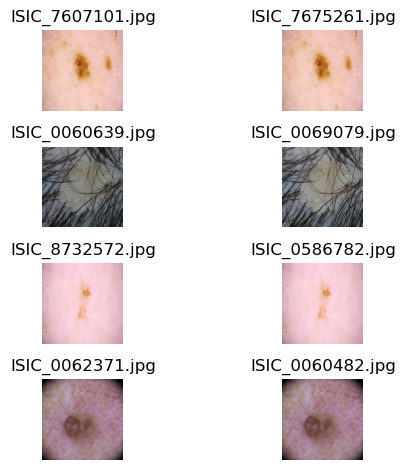

In [77]:
t = ['ISIC_2718135', 'ISIC_9409255']
t = ['ISIC_0072170', 'ISIC_0065795']

a = 'content/2019/train/'+t[0]
a
ix=0
for _r in range(r):
  count = 0
  ix = ix+ 1
  ix = random.randint(0, df.shape[0]-1)
  if ix == 4:
    break
  for _c in range(c):
    ax = plt.subplot(r, c, _r*c + _c + 1)
    t = [df['image_id'][ix], df['image_pair'][ix]]
    if count == 1:
      t_ = t[count][2:-2]
      img = cv2.imread('data/'+t[count][2:-2])
    else:
      t_ = t[count]
      img = cv2.imread('data/'+t[count])
    img = cv2.resize(img, (224,224))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.title(t_, fontsize=12)
    plt.axis("off")
    plt.imshow(img)
    count=count+1
plt.tight_layout()
plt.show()

### view 2

In [78]:
# do some imports for plotting
from pathlib import Path
from imagededup.utils import plot_duplicates
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = (15, 10)

### generate csv duplicates

In [79]:
from pathlib import Path

base_dir = r"D:\FINAL_PROJECT\data"
filenames_2020 = set([i.name for i in Path(base_dir).glob('*.jpg')])

# Keep only filenames that are in 2020 train set
duplicates_2020 = {}
for k, v in duplicates.items():
    if k in filenames_2020:
        tmp = [i for i in v if i in filenames_2020]
        duplicates_2020[k] = tmp

# Sort in descending order of duplicates
duplicates_2020 = {k: v for k, v in sorted(duplicates_2020.items(), key=lambda x: len(x[1]), reverse=True)}

In [81]:
t = []
for e in duplicates_2020.items():
  if e[1]:
    l = e[0],e[1][0]
    t.append(l)
  else:
    pass
df_ = pd.DataFrame(t, columns=['image_id', 'image_pair'])
df_.to_csv(f'results/duplicates_whole_filenames.csv', index=False)

### load csv duplicates

In [23]:
df_.shape

(1165, 2)

In [82]:
duplicates = pd.read_csv(f'results/duplicates_whole_filenames.csv').reset_index(drop=True)
duplicates.shape

(1165, 2)

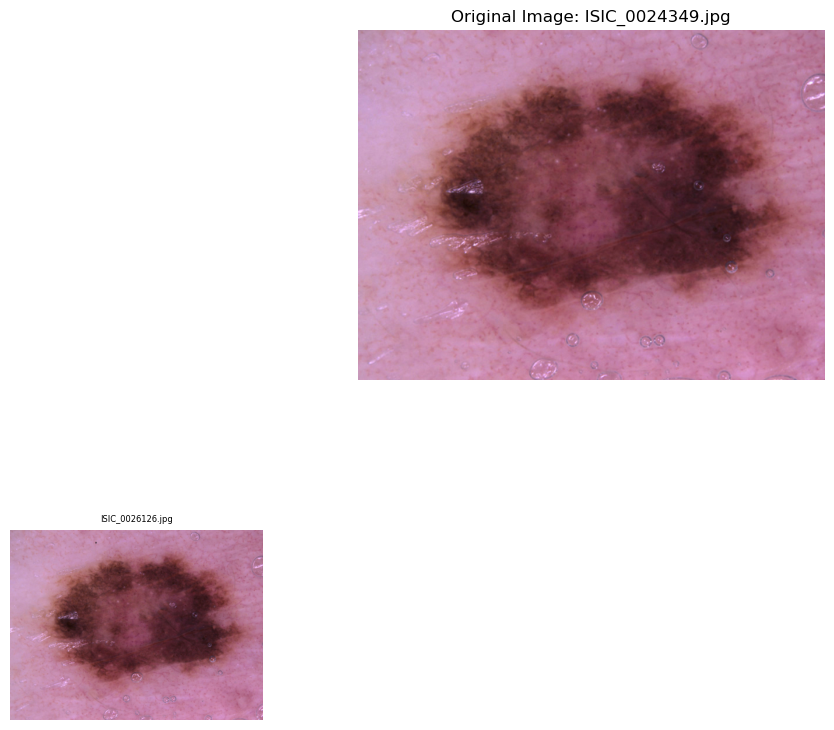

In [83]:
plot_duplicates(image_dir='data', duplicate_map=duplicates_2020, filename=list(duplicates_2020.keys())[51])

In [84]:
filenames_2019 = set([i.name for i in Path('/content/2019/train').glob('*.jpg')])

# keep only filenames that are in 2019 set
duplicates_2019 = {}
for k, v in duplicates.items():
  if k in filenames_2019:
    print(k)
    tmp = [i for i in v if i in filenames_2019]
    duplicates_2019[k] = tmp    

# sort in descending order of duplicates
duplicates_2019 = {k: v for k, v in sorted(duplicates_2019.items(), key=lambda x: len(x[1]), reverse=True)}

In [85]:
print("Duplicates in 2019:", len(duplicates_2019))

Duplicates in 2019: 0


In [89]:
t = []
for e in duplicates_2019.items():
  if e[1]:
    l = e[0],e[1]
    t.append(e)
  else:
    pass
df_ = pd.DataFrame(t, columns=['image_id', 'image_pair'])
df_.to_csv('results/duplicates_2019.csv', index=False)
df_.shape

(0, 2)

In [90]:
# keep only filenames that are in test set have duplicates in train set
duplicates_2020_2019 = {}
for k, v in duplicates.items():
    if k in filenames_2020:
        tmp = [i for i in v if i in filenames_2020]
        duplicates_2020_2019[k] = tmp
    
# sort in descending order of duplicates
duplicates_2020_2019 = {k: v for k, v in sorted(duplicates_2020_2019.items(), key=lambda x: len(x[1]), reverse=True)}

In [91]:
plot_duplicates(image_dir='data', duplicate_map=duplicates_2020_2019, filename=list(duplicates_2020_2019.keys())[50])

IndexError: list index out of range

In [92]:
df_ = pd.read_csv(f'results/whole_data.csv').reset_index(drop=True)
print(df_['diagnosis'].value_counts())
df, df_val = train_test_split(df_, random_state=42, test_size=0.125, shuffle=True, stratify=df_['target'])
df.to_csv(f'results/train_whole_60_no_duplicates.csv', index=False)
df_val.to_csv(f'results/val_whole_60_no_duplicates.csv', index=False)
print(df.shape, df_val.shape)
df = None
df_ = None
df_val = None

diagnosis
UNK     33084
NV      19034
MEL      5608
BCC      3425
BKL      3115
AK        927
SCC       628
DF        319
VASC      282
Name: count, dtype: int64
(58119, 7) (8303, 7)


## Remove duplicates

In [93]:
df_ = pd.read_csv(f'whole_data.csv').reset_index(drop=True)
print(df_.shape)
df_.diagnosis.value_counts()

(66422, 7)


diagnosis
UNK     33084
NV      19034
MEL      5608
BCC      3425
BKL      3115
AK        927
SCC       628
DF        319
VASC      282
Name: count, dtype: int64

In [94]:
duplicates = pd.read_csv(f'results/duplicates_whole_filenames.csv').reset_index(drop=True)
df_['temporal_image'] = df_.image[df_.image.notnull()] + '.jpg'
df_ = df_[~df_.temporal_image.isin(duplicates.image_pair)]
df_.shape

(65264, 8)

In [95]:
df_.to_csv(f'results/whole_data_no_duplicates.csv', index=False)

In [96]:
from sklearn.model_selection import train_test_split
df_ = pd.read_csv(f'results/whole_data_no_duplicates.csv').reset_index(drop=True)
print(df_['diagnosis'].value_counts())
df, df_val = train_test_split(df_, random_state=42, test_size=0.136, shuffle=True, stratify=df_['target'])
df.to_csv(f'results/train_whole_no_duplicates.csv', index=False)
df_val.to_csv(f'results/val_whole_no_duplicates.csv', index=False)
print(df.shape, df_val.shape)
df = None
df_ = None
df_val = None

diagnosis
UNK     32189
NV      18916
MEL      5553
BCC      3396
BKL      3074
AK        907
SCC       628
DF        319
VASC      282
Name: count, dtype: int64
(56388, 8) (8876, 8)


# EDA

In [103]:
# df = pd.read_csv('./whole_data.csv')
df = pd.read_csv(f'results/whole_data_no_duplicates.csv').reset_index(drop=True)

In [104]:
# df = test
df.shape

(65264, 8)

## Visualize

In [105]:
df

,image,path,diagnosis,age_approx,anatom_site_general,sex,target,temporal_image
0,ISIC_0000000,content/2019/train/ISIC_0000000.jpg,NV,55.0,anterior torso,female,5,ISIC_0000000.jpg
1,ISIC_0000001,content/2019/train/ISIC_0000001.jpg,NV,30.0,anterior torso,female,5,ISIC_0000001.jpg
2,ISIC_0000002,content/2019/train/ISIC_0000002.jpg,MEL,60.0,upper extremity,female,4,ISIC_0000002.jpg
3,ISIC_0000003,content/2019/train/ISIC_0000003.jpg,NV,30.0,upper extremity,male,5,ISIC_0000003.jpg
4,ISIC_0000004,content/2019/train/ISIC_0000004.jpg,MEL,80.0,posterior torso,male,4,ISIC_0000004.jpg
...,...,...,...,...,...,...,...,...
65259,NaN,content/2019/med-node/naevus/458192.jpg,NV,NaN,NaN,NaN,5,NaN
65260,NaN,content/2019/med-node/naevus/497621.jpg,NV,NaN,NaN,NaN,5,NaN
65261,NaN,content/2019/med-node/naevus/499701.jpg,NV,NaN,NaN,NaN,5,NaN
65262,NaN,content/2019/med-node/naevus/515125.jpg,NV,NaN,NaN,NaN,5,NaN


In [50]:
def crop_microscopy(img):
  gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_OTSU + cv2.THRESH_BINARY)[1]
  # Find contour and sort by contour area
  cnts = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
  cnts = cnts[0] if len(cnts) == 2 else cnts[1]
  cnts = sorted(cnts, key=cv2.contourArea, reverse=True)
  # Find bounding box and extract ROI
  for c in cnts:
    x,y,w,h = cv2.boundingRect(c)
    ROI = img[y:y+h, x:x+w]
    break
  return ROI
  # cv2_imshow(ROI)
  # print(ROI.shape)

In [51]:
import random
import matplotlib.pyplot as plt
import numpy as np
import cv2
def visualize_images(df, target=np.random.randint(8) ,row_col=(4,4), figsize=(12,12), microscopy_crop=False):
  plt.figure(figsize=figsize)
  plt.tight_layout
  p = np.array(df[df['target']==target].loc[:,'path'])
  t = np.array(df[df['target']==target].loc[:,'diagnosis'])
  row, col = row_col
  for k in range(row*col):
    try:
      r = np.random.randint(len(t)-1)
    except:
      continue
    l = t[r];i = p[r]
    img = cv2.imread(i); 
    img = cv2.resize(img, (224,244))
    if microscopy_crop:
      img = crop_microscopy(img)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  
    plt.subplot(row,col,k+1); plt.imshow(img/255.)
    plt.title(t[r], fontsize=12); plt.axis("off")
    # plt.title(p[r], fontsize=12); plt.axis("off")

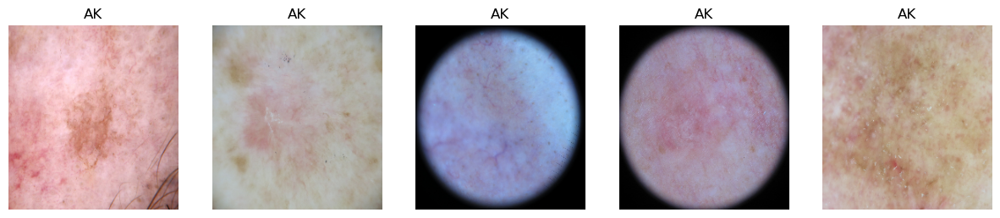

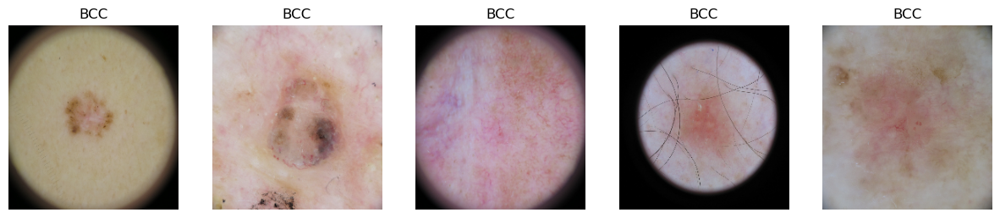

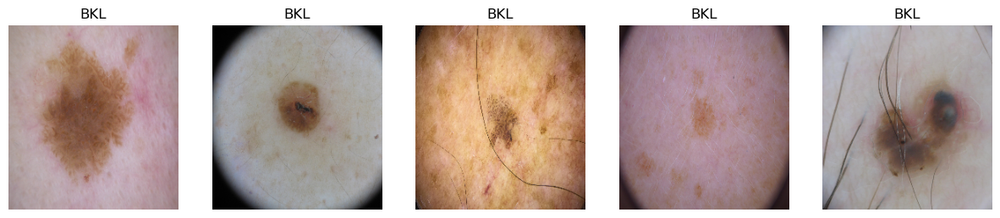

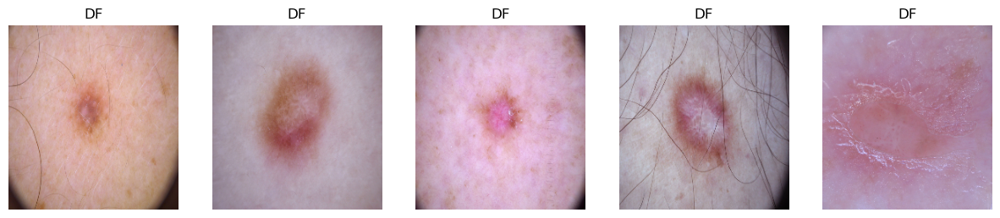

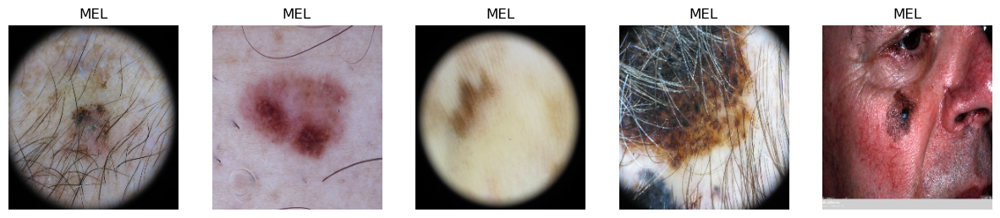

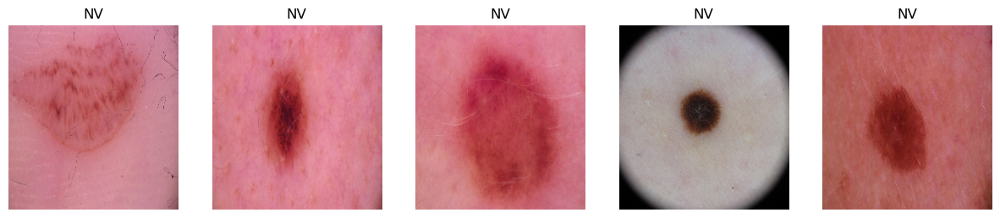

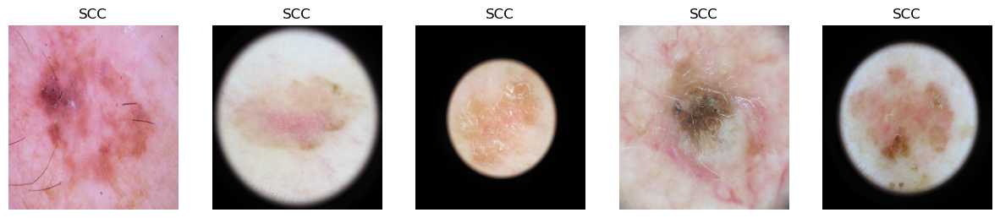

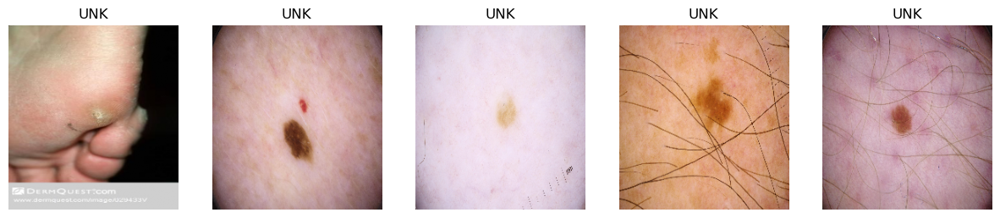

In [108]:
for i in range(8):
  visualize_images(df,i, row_col=(1,5), figsize= (15,15))

In [45]:
# check skinl_v1_v2_v3 crop
# from google.colab.patches import cv2_imshow
# # t.reset.reset_index(inplace=True)
# img = cv2.imread(t.name[3])
# img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) 
# img_ = crop_microscopy(img)
# cv2_imshow(img_)
# print(img.shape, img_.shape)

## Outliers with mean and standard deviation

[@Ram(ji)](https://www.kaggle.com/code/ramjib/cassava-leaf-disease-eda-and-outliers/notebook) based EDA


Size and Aspect ratio

In [5]:
df = pd.read_csv(f'results/whole_data_no_duplicates.csv').reset_index(drop=True)
df

,image,path,diagnosis,age_approx,anatom_site_general,sex,target,temporal_image
0,ISIC_0000000,content/2019/train/ISIC_0000000.jpg,NV,55.0,anterior torso,female,5,ISIC_0000000.jpg
1,ISIC_0000001,content/2019/train/ISIC_0000001.jpg,NV,30.0,anterior torso,female,5,ISIC_0000001.jpg
2,ISIC_0000002,content/2019/train/ISIC_0000002.jpg,MEL,60.0,upper extremity,female,4,ISIC_0000002.jpg
3,ISIC_0000003,content/2019/train/ISIC_0000003.jpg,NV,30.0,upper extremity,male,5,ISIC_0000003.jpg
4,ISIC_0000004,content/2019/train/ISIC_0000004.jpg,MEL,80.0,posterior torso,male,4,ISIC_0000004.jpg
...,...,...,...,...,...,...,...,...
65259,NaN,content/2019/med-node/naevus/458192.jpg,NV,NaN,NaN,NaN,5,NaN
65260,NaN,content/2019/med-node/naevus/497621.jpg,NV,NaN,NaN,NaN,5,NaN
65261,NaN,content/2019/med-node/naevus/499701.jpg,NV,NaN,NaN,NaN,5,NaN
65262,NaN,content/2019/med-node/naevus/515125.jpg,NV,NaN,NaN,NaN,5,NaN


In [111]:
from tqdm import tqdm
import cv2

df0 = df.iloc[:10000].copy()

for idx in tqdm(df0.index):
    img_name = df0.loc[idx,'path']
    img = cv2.cvtColor(cv2.imread(df0.path[idx]), cv2.COLOR_BGR2RGB)    
    w,h,_ = img.shape
    df0.loc[idx,'width'] = w
    df0.loc[idx,'height'] = h
    df0.loc[idx,'ratio'] = w/h

    df0.loc[idx,'mean'] = img.mean()
    df0.loc[idx,'std'] = img.std()
    
    img_norm = cv2.normalize(img, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
    df0.loc[idx,'mean_norm'] = img_norm.mean()
    df0.loc[idx,'std_norm'] = img_norm.std()

100%|████████████████████████████████████████████████████████████████████████████| 10000/10000 [03:26<00:00, 48.54it/s]


In [112]:
df1 = df.iloc[10000:20000].copy()

for idx in tqdm(df1.index):
    img_name = df1.loc[idx,'path']
    img = cv2.cvtColor(cv2.imread(df1.path[idx]), cv2.COLOR_BGR2RGB)    
    w,h,_ = img.shape
    df1.loc[idx,'width'] = w
    df1.loc[idx,'height'] = h
    df1.loc[idx,'ratio'] = w/h

    df1.loc[idx,'mean'] = img.mean()
    df1.loc[idx,'std'] = img.std()
    
    img_norm = cv2.normalize(img, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
    df1.loc[idx,'mean_norm'] = img_norm.mean()
    df1.loc[idx,'std_norm'] = img_norm.std()

100%|████████████████████████████████████████████████████████████████████████████| 10000/10000 [05:39<00:00, 29.44it/s]


In [113]:
df2 = df.iloc[20000:30000].copy()

for idx in tqdm(df2.index):
    img_name = df2.loc[idx,'path']
    img = cv2.cvtColor(cv2.imread(df2.path[idx]), cv2.COLOR_BGR2RGB)    
    w,h,_ = img.shape
    df2.loc[idx,'width'] = w
    df2.loc[idx,'height'] = h
    df2.loc[idx,'ratio'] = w/h

    df2.loc[idx,'mean'] = img.mean()
    df2.loc[idx,'std'] = img.std()
    
    img_norm = cv2.normalize(img, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
    df2.loc[idx,'mean_norm'] = img_norm.mean()
    df2.loc[idx,'std_norm'] = img_norm.std()

100%|████████████████████████████████████████████████████████████████████████████| 10000/10000 [36:50<00:00,  4.52it/s]


In [115]:
df_123 = pd.concat([df0, df1, df2], ignore_index=True)
df_123

,image,path,diagnosis,age_approx,anatom_site_general,sex,target,temporal_image,width,height,ratio,mean,std,mean_norm,std_norm
0,ISIC_0000000,content/2019/train/ISIC_0000000.jpg,NV,55.0,anterior torso,female,5,ISIC_0000000.jpg,767.0,1022.0,0.750489,150.324133,72.349294,0.562026,0.302717
1,ISIC_0000001,content/2019/train/ISIC_0000001.jpg,NV,30.0,anterior torso,female,5,ISIC_0000001.jpg,767.0,1022.0,0.750489,164.697057,32.012931,0.638788,0.128052
2,ISIC_0000002,content/2019/train/ISIC_0000002.jpg,MEL,60.0,upper extremity,female,4,ISIC_0000002.jpg,767.0,1022.0,0.750489,158.165772,54.187265,0.620258,0.212499
3,ISIC_0000003,content/2019/train/ISIC_0000003.jpg,NV,30.0,upper extremity,male,5,ISIC_0000003.jpg,767.0,1022.0,0.750489,178.488800,61.300297,0.681203,0.255418
4,ISIC_0000004,content/2019/train/ISIC_0000004.jpg,MEL,80.0,posterior torso,male,4,ISIC_0000004.jpg,767.0,1022.0,0.750489,79.599645,88.614095,0.312156,0.347506
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,ISIC_1615996,content/2020/train/ISIC_1615996.jpg,UNK,75.0,torso,male,7,ISIC_1615996.jpg,3456.0,5184.0,0.666667,180.305417,36.437056,0.707081,0.142890
29996,ISIC_1616031,content/2020/train/ISIC_1616031.jpg,MEL,50.0,torso,male,4,ISIC_1616031.jpg,3456.0,5184.0,0.666667,168.090361,42.932811,0.659178,0.168364
29997,ISIC_1616451,content/2020/train/ISIC_1616451.jpg,UNK,65.0,torso,male,7,ISIC_1616451.jpg,4000.0,6000.0,0.666667,193.515908,32.971576,0.758886,0.129300
29998,ISIC_1616809,content/2020/train/ISIC_1616809.jpg,UNK,65.0,torso,male,7,ISIC_1616809.jpg,4000.0,6000.0,0.666667,168.153341,46.870834,0.659425,0.183807


In [116]:
df_123.to_csv("results/firsthalf_123.csv")

In [6]:
import cv2
from tqdm import tqdm
import os
df3 = df.iloc[30000:40000].copy()

for idx in tqdm(df3.index):
    img_name = df3.loc[idx, 'path']
    img = cv2.cvtColor(cv2.imread(df3.path[idx]), cv2.COLOR_BGR2RGB)
    w, h, _ = img.shape
    df3.loc[idx, 'width'] = w
    df3.loc[idx, 'height'] = h
    df3.loc[idx, 'ratio'] = w / h
    
    df3.loc[idx, 'mean'] = img.mean()
    df3.loc[idx, 'std'] = img.std()
    
    img_norm = cv2.normalize(img, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
    df3.loc[idx, 'mean_norm'] = img_norm.mean()
    df3.loc[idx, 'std_norm'] = img_norm.std()

100%|██████████████████████████████████████████████████████████████████████████| 10000/10000 [1:05:26<00:00,  2.55it/s]


In [7]:
df4 = df.iloc[40000:50000].copy()

for idx in tqdm(df4.index):
    img_name = df4.loc[idx, 'path']
    img = cv2.cvtColor(cv2.imread(df4.path[idx]), cv2.COLOR_BGR2RGB)
    w, h, _ = img.shape
    df4.loc[idx, 'width'] = w
    df4.loc[idx, 'height'] = h
    df4.loc[idx, 'ratio'] = w / h
    
    df4.loc[idx, 'mean'] = img.mean()
    df4.loc[idx, 'std'] = img.std()
    
    img_norm = cv2.normalize(img, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
    df4.loc[idx, 'mean_norm'] = img_norm.mean()
    df4.loc[idx, 'std_norm'] = img_norm.std()

100%|██████████████████████████████████████████████████████████████████████████| 10000/10000 [1:05:06<00:00,  2.56it/s]


In [8]:
df5 = df.iloc[50000:60000].copy()

for idx in tqdm(df5.index):
    img_name = df5.loc[idx, 'path']
    img = cv2.cvtColor(cv2.imread(df5.path[idx]), cv2.COLOR_BGR2RGB)
    w, h, _ = img.shape
    df5.loc[idx, 'width'] = w
    df5.loc[idx, 'height'] = h
    df5.loc[idx, 'ratio'] = w / h
    
    df5.loc[idx, 'mean'] = img.mean()
    df5.loc[idx, 'std'] = img.std()
    
    img_norm = cv2.normalize(img, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
    df5.loc[idx, 'mean_norm'] = img_norm.mean()
    df5.loc[idx, 'std_norm'] = img_norm.std()

100%|████████████████████████████████████████████████████████████████████████████| 10000/10000 [49:14<00:00,  3.38it/s]


In [9]:
df6 = df.iloc[60000:].copy()

for idx in tqdm(df6.index):
    img_name = df6.loc[idx, 'path']
    img = cv2.imread(img_name)  # Read the image

    if img is None:  # Check if image exists
        print(f"Warning: Could not read {img_name}, skipping...")
        continue  # Skip this iteration if the image is missing

    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert color space
    w, h, _ = img.shape
    df6.loc[idx, 'width'] = w
    df6.loc[idx, 'height'] = h
    df6.loc[idx, 'ratio'] = w / h

    df6.loc[idx, 'mean'] = img.mean()
    df6.loc[idx, 'std'] = img.std()

    img_norm = cv2.normalize(img, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
    df6.loc[idx, 'mean_norm'] = img_norm.mean()
    df6.loc[idx, 'std_norm'] = img_norm.std()

100%|██████████████████████████████████████████████████████████████████████████████| 5264/5264 [03:36<00:00, 24.31it/s]


In [10]:
df_3456 = pd.concat([df3, df4, df5, df6], ignore_index=True)
df_3456

,image,path,diagnosis,age_approx,anatom_site_general,sex,target,temporal_image,width,height,ratio,mean,std,mean_norm,std_norm
0,ISIC_1617282,content/2020/train/ISIC_1617282.jpg,UNK,70.0,lower extremity,female,7,ISIC_1617282.jpg,3456.0,5184.0,0.666667,176.222649,29.245141,0.679767,0.118883
1,ISIC_1617520,content/2020/train/ISIC_1617520.jpg,UNK,25.0,torso,female,7,ISIC_1617520.jpg,4000.0,6000.0,0.666667,206.941915,32.168698,0.805434,0.130238
2,ISIC_1617676,content/2020/train/ISIC_1617676.jpg,NV,75.0,lower extremity,male,5,ISIC_1617676.jpg,1053.0,1872.0,0.562500,116.616711,44.560872,0.450860,0.176829
3,ISIC_1617888,content/2020/train/ISIC_1617888.jpg,UNK,65.0,torso,male,7,ISIC_1617888.jpg,4000.0,6000.0,0.666667,184.957687,39.426795,0.725325,0.154615
4,ISIC_1618302,content/2020/train/ISIC_1618302.jpg,NV,50.0,torso,male,5,ISIC_1618302.jpg,1053.0,1872.0,0.562500,158.574595,47.902965,0.637601,0.196324
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35259,NaN,content/2019/med-node/naevus/458192.jpg,NV,NaN,NaN,NaN,5,NaN,596.0,685.0,0.870073,113.480623,44.941353,0.464531,0.211988
35260,NaN,content/2019/med-node/naevus/497621.jpg,NV,NaN,NaN,NaN,5,NaN,1271.0,1174.0,1.082624,125.137407,42.960979,0.462160,0.194394
35261,NaN,content/2019/med-node/naevus/499701.jpg,NV,NaN,NaN,NaN,5,NaN,633.0,616.0,1.027597,117.448255,47.436365,0.494493,0.248358
35262,NaN,content/2019/med-node/naevus/515125.jpg,NV,NaN,NaN,NaN,5,NaN,422.0,405.0,1.041975,111.479424,46.857950,0.449134,0.237858


In [11]:
df_3456.to_csv("results/secondhalf_3456.csv")

In [14]:
df123 = pd.read_csv("results/firsthalf_123.csv")

In [16]:
df = pd.concat([df123, df_3456], ignore_index=True)
df

,Unnamed: 0,image,path,diagnosis,age_approx,anatom_site_general,sex,target,temporal_image,width,height,ratio,mean,std,mean_norm,std_norm
0,0.0,ISIC_0000000,content/2019/train/ISIC_0000000.jpg,NV,55.0,anterior torso,female,5,ISIC_0000000.jpg,767.0,1022.0,0.750489,150.324133,72.349294,0.562026,0.302717
1,1.0,ISIC_0000001,content/2019/train/ISIC_0000001.jpg,NV,30.0,anterior torso,female,5,ISIC_0000001.jpg,767.0,1022.0,0.750489,164.697057,32.012931,0.638788,0.128052
2,2.0,ISIC_0000002,content/2019/train/ISIC_0000002.jpg,MEL,60.0,upper extremity,female,4,ISIC_0000002.jpg,767.0,1022.0,0.750489,158.165772,54.187265,0.620258,0.212499
3,3.0,ISIC_0000003,content/2019/train/ISIC_0000003.jpg,NV,30.0,upper extremity,male,5,ISIC_0000003.jpg,767.0,1022.0,0.750489,178.488800,61.300297,0.681203,0.255418
4,4.0,ISIC_0000004,content/2019/train/ISIC_0000004.jpg,MEL,80.0,posterior torso,male,4,ISIC_0000004.jpg,767.0,1022.0,0.750489,79.599645,88.614095,0.312156,0.347506
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
65259,NaN,NaN,content/2019/med-node/naevus/458192.jpg,NV,NaN,NaN,NaN,5,NaN,596.0,685.0,0.870073,113.480623,44.941353,0.464531,0.211988
65260,NaN,NaN,content/2019/med-node/naevus/497621.jpg,NV,NaN,NaN,NaN,5,NaN,1271.0,1174.0,1.082624,125.137407,42.960979,0.462160,0.194394
65261,NaN,NaN,content/2019/med-node/naevus/499701.jpg,NV,NaN,NaN,NaN,5,NaN,633.0,616.0,1.027597,117.448255,47.436365,0.494493,0.248358
65262,NaN,NaN,content/2019/med-node/naevus/515125.jpg,NV,NaN,NaN,NaN,5,NaN,422.0,405.0,1.041975,111.479424,46.857950,0.449134,0.237858


In [17]:
df.to_csv("results/whole_mean_std.csv", index=False)
df = pd.read_csv("results/whole_mean_std.csv").reset_index(drop=True)
df

,Unnamed: 0,image,path,diagnosis,age_approx,anatom_site_general,sex,target,temporal_image,width,height,ratio,mean,std,mean_norm,std_norm
0,0.0,ISIC_0000000,content/2019/train/ISIC_0000000.jpg,NV,55.0,anterior torso,female,5,ISIC_0000000.jpg,767.0,1022.0,0.750489,150.324133,72.349294,0.562026,0.302717
1,1.0,ISIC_0000001,content/2019/train/ISIC_0000001.jpg,NV,30.0,anterior torso,female,5,ISIC_0000001.jpg,767.0,1022.0,0.750489,164.697057,32.012931,0.638788,0.128052
2,2.0,ISIC_0000002,content/2019/train/ISIC_0000002.jpg,MEL,60.0,upper extremity,female,4,ISIC_0000002.jpg,767.0,1022.0,0.750489,158.165772,54.187265,0.620258,0.212499
3,3.0,ISIC_0000003,content/2019/train/ISIC_0000003.jpg,NV,30.0,upper extremity,male,5,ISIC_0000003.jpg,767.0,1022.0,0.750489,178.488800,61.300297,0.681203,0.255418
4,4.0,ISIC_0000004,content/2019/train/ISIC_0000004.jpg,MEL,80.0,posterior torso,male,4,ISIC_0000004.jpg,767.0,1022.0,0.750489,79.599645,88.614095,0.312156,0.347506
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
65259,NaN,NaN,content/2019/med-node/naevus/458192.jpg,NV,NaN,NaN,NaN,5,NaN,596.0,685.0,0.870073,113.480623,44.941353,0.464531,0.211988
65260,NaN,NaN,content/2019/med-node/naevus/497621.jpg,NV,NaN,NaN,NaN,5,NaN,1271.0,1174.0,1.082624,125.137407,42.960979,0.462160,0.194394
65261,NaN,NaN,content/2019/med-node/naevus/499701.jpg,NV,NaN,NaN,NaN,5,NaN,633.0,616.0,1.027597,117.448255,47.436365,0.494493,0.248358
65262,NaN,NaN,content/2019/med-node/naevus/515125.jpg,NV,NaN,NaN,NaN,5,NaN,422.0,405.0,1.041975,111.479424,46.857950,0.449134,0.237858


In [18]:
df.to_csv("results/test_mean_std.csv", index=False)

In [12]:
import pandas as pd
df = pd.read_csv("results/test_mean_std.csv").reset_index(drop=True)

In [13]:
df = df.loc[:57458]

### Scatter plot

In [14]:
import plotly.io as pio
pio.renderers.default = "png"  # Displays static images in the notebook

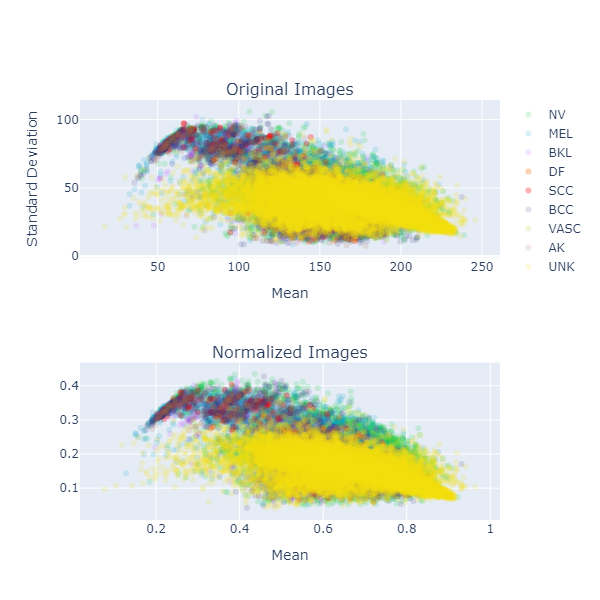

In [15]:
from plotly.subplots import make_subplots
import plotly
import plotly.graph_objects as go

import plotly.figure_factory as ff
import seaborn as sns
import matplotlib.pyplot as plt

fig =  make_subplots(rows=2,cols=1,subplot_titles=['Original Images', 'Normalized Images'])
colors = ['rgba(13, 200, 58, 0.15)','rgba(13, 160, 200, 0.15)','rgba(190, 81, 249, 0.15)','rgba(255, 102, 6, 0.3)','rgba(255, 0, 0, 0.3)','rgba(53, 51, 120, 0.15)','rgba(136, 206, 14, 0.15)','rgba(159, 96, 67, 0.15)','rgba(237, 218, 14, 0.15)']

for idx,class_name in enumerate(df['diagnosis'].unique()):
    #scatter plot between mean and variance of the images for every disease
    fig.add_trace(go.Scatter(x=df[df['diagnosis'] == class_name]['mean'],
                             y=df[df['diagnosis'] == class_name]['std'],
                            mode = 'markers',name=class_name,
                            marker_color=colors[idx]),1,1)
    
    #scatter plot between mean and variance of the normalized images for every disease
    fig.add_trace(go.Scatter(x=df[df['diagnosis'] == class_name]['mean_norm'],
                             y=df[df['diagnosis'] == class_name]['std_norm'],
                            mode = 'markers',name=class_name,
                            marker_color=colors[idx], showlegend=False),2,1)
#x-axis and y axis title
fig.update_layout(autosize=False, width=600, height=600)
fig.update_xaxes(title_text="Mean", row=1, col=1)
fig.update_yaxes(title_text="Standard Deviation", row=1, col=1)

fig.update_xaxes(title_text="Mean", row=2, col=1)
fig.update_yaxes(title_text="Standard Deviation", row=1, col=1)
fig.show()

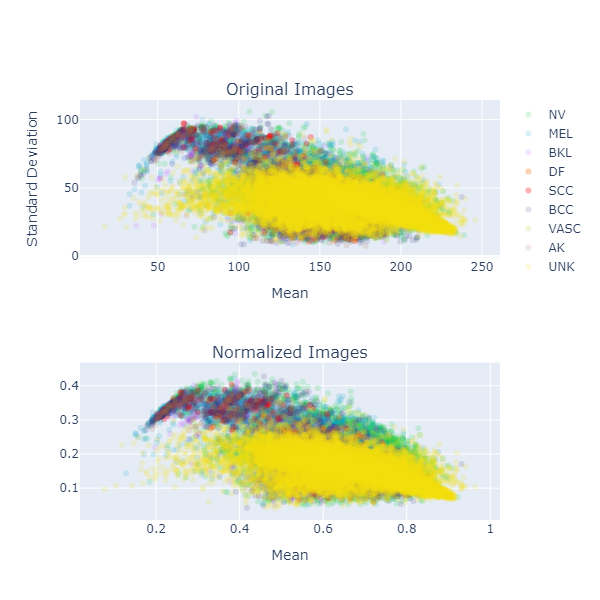

In [16]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

import plotly.figure_factory as ff
import seaborn as sns
import matplotlib.pyplot as plt

fig =  make_subplots(rows=2,cols=1,subplot_titles=['Original Images', 'Normalized Images'])
colors = ['rgba(13, 200, 58, 0.15)','rgba(13, 160, 200, 0.15)','rgba(190, 81, 249, 0.15)','rgba(255, 102, 6, 0.3)','rgba(255, 0, 0, 0.3)','rgba(53, 51, 120, 0.15)','rgba(136, 206, 14, 0.15)','rgba(159, 96, 67, 0.15)','rgba(237, 218, 14, 0.15)']

for idx,class_name in enumerate(df['diagnosis'].unique()):
    #scatter plot between mean and variance of the images for every disease
    fig.add_trace(go.Scatter(x=df[df['diagnosis'] == class_name]['mean'],
                             y=df[df['diagnosis'] == class_name]['std'],
                            mode = 'markers',name=class_name,
                            marker_color=colors[idx]),1,1)
    
    #scatter plot between mean and variance of the normalized images for every disease
    fig.add_trace(go.Scatter(x=df[df['diagnosis'] == class_name]['mean_norm'],
                             y=df[df['diagnosis'] == class_name]['std_norm'],
                            mode = 'markers',name=class_name,
                            marker_color=colors[idx], showlegend=False),2,1)
#x-axis and y axis title
fig.update_layout(autosize=False, width=600, height=600)
fig.update_xaxes(title_text="Mean", row=1, col=1)
fig.update_yaxes(title_text="Standard Deviation", row=1, col=1)

fig.update_xaxes(title_text="Mean", row=2, col=1)
fig.update_yaxes(title_text="Standard Deviation", row=1, col=1)
fig.show()
    

Notice, anything outside `0.15` and `0.87` demark outliers. 



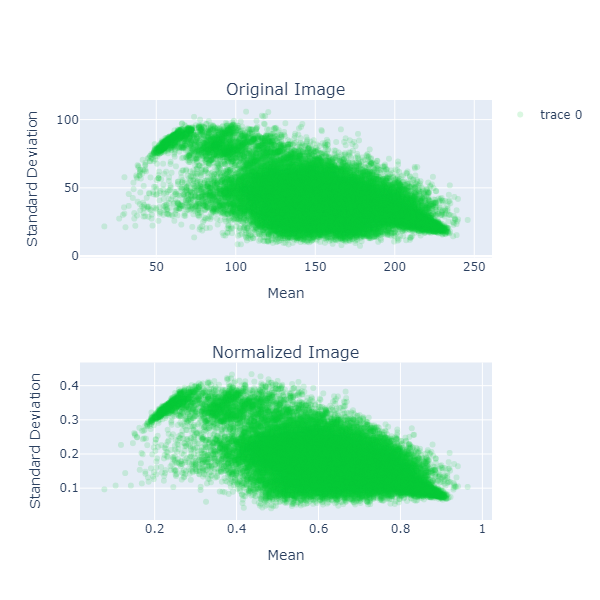

In [17]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

import plotly.figure_factory as ff
import seaborn as sns
import matplotlib.pyplot as plt
import imutils

fig =  make_subplots(rows=2,cols=1,subplot_titles=['Original Image', 'Normalized Image'])
colors = ['rgba(13, 200, 58, 0.15)','rgba(13, 160, 200, 0.15)','rgba(190, 81, 249, 0.15)','rgba(200, 125, 93, 0.15)','rgba(255, 0, 0, 0.3)','rgba(53, 51, 120, 0.15)','rgba(136, 206, 14, 0.15)','rgba(159, 96, 67, 0.15)','rgba(237, 218, 14, 0.15)']

#scatter plot between mean and variance of the images for every disease
fig.add_trace(go.Scatter(x=df['mean'],
                        y=df['std'],
                        mode = 'markers',
                        marker_color=colors[0]),1,1)
    
#scatter plot between mean and variance of the normalized images for every disease
fig.add_trace(go.Scatter(x=df['mean_norm'],
                         y=df['std_norm'],
                         mode = 'markers',
                         marker_color=colors[0], showlegend=False),2,1)
#x-axis and y axis title

fig.update_layout(autosize=False, width=600, height=600)
fig.update_xaxes(title_text="Mean", row=1, col=1)
fig.update_yaxes(title_text="Standard Deviation", row=1, col=1)

fig.update_xaxes(title_text="Mean", row=2, col=1)
fig.update_yaxes(title_text="Standard Deviation", row=2, col=1)
fig.show()

Notice, anything outside `0.18` and `0.85` demark outliers. 

### Box plot

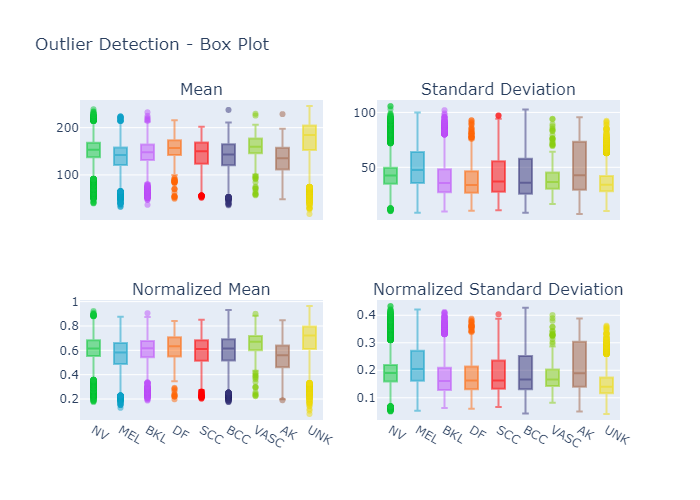

In [18]:
fig = make_subplots(rows=2,cols=2,
                    subplot_titles=['Mean','Standard Deviation','Normalized Mean','Normalized Standard Deviation'],
                    shared_xaxes=True)
colors = ['rgba(13, 200, 58, 0.5)','rgba(13, 160, 200, 0.5)','rgba(190, 81, 249, 0.5)','rgba(255, 102, 6, 0.5)','rgba(255, 0, 0, 0.5)','rgba(53, 51, 120, 0.5)','rgba(136, 206, 14, 0.5)','rgba(159, 96, 67, 0.5)','rgba(237, 218, 14, 0.5)']
for idx,class_name in enumerate(df['diagnosis'].unique()):
    fig.add_trace(go.Box(y=df[df['diagnosis'] == class_name]['mean'],
                        name=class_name,showlegend=False,
                        marker_color=colors[idx]),1,1)
    fig.add_trace(go.Box(y=df[df['diagnosis'] == class_name]['mean_norm'],
                        name=class_name,showlegend=False,
                        marker_color=colors[idx]),2,1)
    fig.add_trace(go.Box(y=df[df['diagnosis'] == class_name]['std'],
                        name=class_name,showlegend=False,
                        marker_color=colors[idx]),1,2)
    fig.add_trace(go.Box(y=df[df['diagnosis'] == class_name]['std_norm'],
                        name=class_name,showlegend=False,
                        marker_color=colors[idx]),2,2)
fig.update_layout(title='Outlier Detection - Box Plot')
fig.show()

In [19]:
higher_mean_nv, lower_mean_nv = 0.87, 0.35
higher_mean_mel, lower_mean_mel = 0.65, 0.27
higher_mean_bkl, lower_mean_bkl = 0.86, 0.35
higher_mean_df, lower_mean_df = 0.70, 0.44
higher_mean_scc, lower_mean_scc = 0.85, 0.40
higher_mean_bcc, lower_mean_bcc = 0.86, 0.54
higher_mean_vasc, lower_mean_vasc = 0.88, 0.59
higher_mean_ak, lower_mean_ak = 0.82, 0.33
higher_mean_unk, lower_mean_unk = 0.79, 0.34

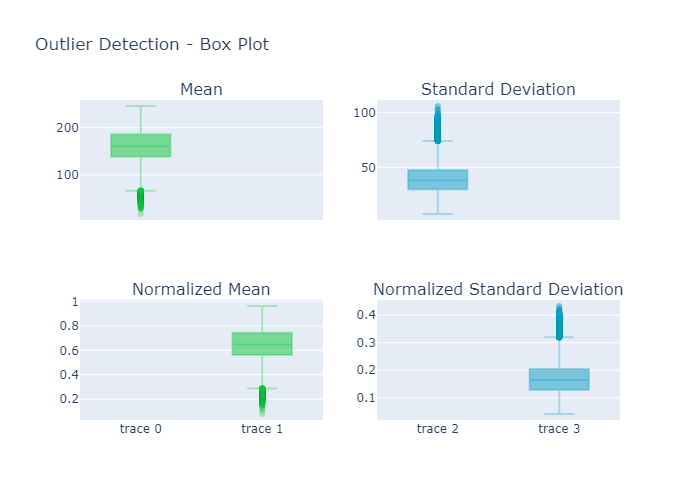

In [20]:
# test
fig = make_subplots(rows=2,cols=2,
                    subplot_titles=['Mean','Standard Deviation','Normalized Mean','Normalized Standard Deviation'],
                    shared_xaxes=True)
colors = ['rgba(13, 200, 58, 0.3)','rgba(13, 160, 200, 0.3)','rgba(190, 81, 249, 0.3)','rgba(248, 104, 73, 0.3)','rgba(243, 247, 15, 0.3)','rgba(53, 51, 120, 0.3)','rgba(136, 206, 14, 0.3)','rgba(159, 96, 67, 0.3)','rgba(237, 218, 14, 0.3)']
fig.add_trace(go.Box(y=df['mean'],
                    showlegend=False,
                    marker_color=colors[0]),1,1)
fig.add_trace(go.Box(y=df['mean_norm'],
                    showlegend=False,
                    marker_color=colors[0]),2,1)
fig.add_trace(go.Box(y=df['std'],
                    showlegend=False,
                    marker_color=colors[1]),1,2)
fig.add_trace(go.Box(y=df['std_norm'],
                    showlegend=False,
                    marker_color=colors[1]),2,2)
fig.update_layout(title='Outlier Detection - Box Plot')
fig.show()

In [21]:
lower_mean_nv,higher_mean_nv

(0.35, 0.87)

### Outliers per class

In [22]:
higher_mean_nv, lower_mean_nv = 0.87, 0.35
higher_mean_mel, lower_mean_mel = 0.65, 0.27
higher_mean_bkl, lower_mean_bkl = 0.86, 0.35
higher_mean_df, lower_mean_df = 0.70, 0.44
higher_mean_scc, lower_mean_scc = 0.85, 0.40
higher_mean_bcc, lower_mean_bcc = 0.86, 0.54
higher_mean_vasc, lower_mean_vasc = 0.88, 0.59
higher_mean_ak, lower_mean_ak = 0.82, 0.33
higher_mean_unk, lower_mean_unk = 0.79, 0.34
mean_limits  = list()

mean_limits.append ([higher_mean_nv, lower_mean_nv])
mean_limits.append ([higher_mean_mel, lower_mean_mel])
mean_limits.append ([higher_mean_bkl, lower_mean_bkl])
mean_limits.append ([higher_mean_df, lower_mean_df])
mean_limits.append ([higher_mean_scc, lower_mean_scc])
mean_limits.append ([higher_mean_bcc, lower_mean_bcc])
mean_limits.append ([higher_mean_vasc, lower_mean_vasc])
mean_limits.append ([higher_mean_ak, lower_mean_ak])
mean_limits.append ([higher_mean_unk, lower_mean_unk])

Images for class NV 17950
Outliers: 323

Images for class MEL 5051
Outliers: 1668

Images for class BKL 2806
Outliers: 138

Images for class DF 239
Outliers: 90

Images for class SCC 628
Outliers: 86

Images for class BCC 3294
Outliers: 969

Images for class VASC 253
Outliers: 58

Images for class AK 879
Outliers: 91

Images for class UNK 26359
Outliers: 7397



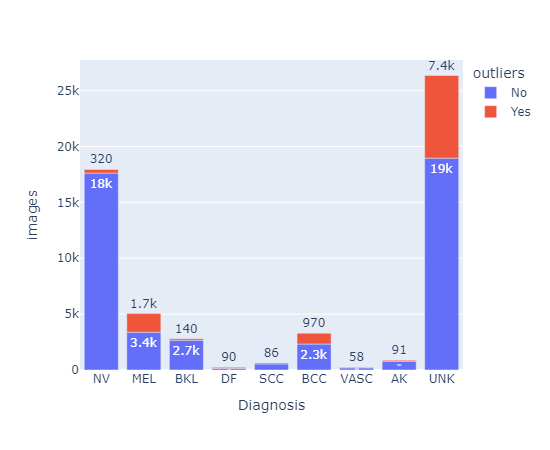

In [23]:
import plotly.express as px
df_temporal = pd.DataFrame(columns = ['diagnosis', 'images', 'outliers'])
df_outlier_ = pd.DataFrame()
df_diagnosis_t = pd.DataFrame()
df_target_t = pd.DataFrame()

df['Diagnosis'] = df.diagnosis
for idx,class_name in enumerate(df['Diagnosis'].unique()): 
  df_class  = df[df['Diagnosis'] ==  class_name]
  print('Images for class '+class_name +' '+str(len(df_class)))
  outliers_ = df_class[df_class['mean_norm'].between(mean_limits[idx][1],mean_limits[idx][0],inclusive='both')]
  outliers_ = df_class[~df_class['image'].isin(outliers_['image'])]
  print('Outliers: '+str(len(outliers_))+'\n') 
  df_outlier_ = pd.concat([df_outlier_,outliers_['path']], ignore_index=True)
  df_diagnosis_t = pd.concat([df_diagnosis_t,outliers_['Diagnosis']], ignore_index=True)
  df_target_t = pd.concat([df_target_t,outliers_['target']], ignore_index=True)
  df_outlier_.loc[idx,'Diagnosis'] = class_name

  df_temporal = pd.concat([df_temporal, pd.DataFrame([{'Diagnosis': class_name, 'images': len(df_class)-len(outliers_), 'outliers': 'No'}])], ignore_index=True)
  df_temporal = pd.concat([df_temporal, pd.DataFrame([{'Diagnosis': class_name, 'images': len(outliers_), 'outliers': 'Yes'}])], ignore_index=True)


df_outlier_.rename(columns = {0:'path'}, inplace = True)
df_outlier_['Diagnosis'] = df_diagnosis_t
df_outlier_['target'] = df_target_t

fig = px.bar(df_temporal, x='Diagnosis', y='images', color='outliers', height=450, width=550, text='images')
fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
fig.show()

In [24]:
df_class = df_class.drop(columns=['Unnamed: 0'])

In [25]:
df_class

,image,path,diagnosis,age_approx,anatom_site_general,sex,target,temporal_image,width,height,ratio,mean,std,mean_norm,std_norm,Diagnosis
25100,ISIC_2637011,content/2020/train/ISIC_2637011.jpg,UNK,45.0,head/neck,male,7,ISIC_2637011.jpg,4000.0,6000.0,0.666667,169.862452,41.270046,0.666128,0.161843,UNK
25101,ISIC_0015719,content/2020/train/ISIC_0015719.jpg,UNK,45.0,upper extremity,female,7,ISIC_0015719.jpg,4000.0,6000.0,0.666667,171.084778,41.994142,0.670919,0.164683,UNK
25103,ISIC_0068279,content/2020/train/ISIC_0068279.jpg,UNK,45.0,head/neck,female,7,ISIC_0068279.jpg,1053.0,1872.0,0.562500,80.342856,44.885518,0.317561,0.177413,UNK
25104,ISIC_0074268,content/2020/train/ISIC_0074268.jpg,UNK,55.0,upper extremity,female,7,ISIC_0074268.jpg,4000.0,6000.0,0.666667,183.955453,37.497829,0.721395,0.147050,UNK
25105,ISIC_0074311,content/2020/train/ISIC_0074311.jpg,UNK,40.0,lower extremity,female,7,ISIC_0074311.jpg,4000.0,6000.0,0.666667,214.015442,32.537278,0.839277,0.127597,UNK
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
57422,NaN,content/2019/SD-198/images/Actinic_solar_Damag...,UNK,NaN,NaN,NaN,7,NaN,1130.0,1640.0,0.689024,143.203219,54.397476,0.561581,0.213323,UNK
57423,NaN,content/2019/SD-198/images/Actinic_solar_Damag...,UNK,NaN,NaN,NaN,7,NaN,1130.0,1640.0,0.689024,124.295222,60.511947,0.487433,0.237302,UNK
57424,NaN,content/2019/SD-198/images/Actinic_solar_Damag...,UNK,NaN,NaN,NaN,7,NaN,1130.0,1640.0,0.689024,121.437108,63.261755,0.476224,0.248085,UNK
57425,NaN,content/2019/SD-198/images/Actinic_solar_Damag...,UNK,NaN,NaN,NaN,7,NaN,1130.0,1640.0,0.689024,116.823872,84.779347,0.458133,0.332468,UNK


In [26]:
df_temporal

,diagnosis,images,outliers,Diagnosis
0,NaN,17627,No,NV
1,NaN,323,Yes,NV
2,NaN,3383,No,MEL
3,NaN,1668,Yes,MEL
4,NaN,2668,No,BKL
5,NaN,138,Yes,BKL
6,NaN,149,No,DF
7,NaN,90,Yes,DF
8,NaN,542,No,SCC
9,NaN,86,Yes,SCC


In [27]:
df_outlier_

,path,Diagnosis,target
0,content/2019/train/ISIC_0000220.jpg,NV,5.0
1,content/2019/train/ISIC_0000492.jpg,NV,5.0
2,content/2019/train/ISIC_0003728_downsampled.jpg,NV,5.0
3,content/2019/train/ISIC_0010177.jpg,NV,5.0
4,content/2019/train/ISIC_0010339.jpg,NV,5.0
...,...,...,...
10815,content/2020/train/ISIC_9996662.jpg,UNK,7.0
10816,content/2020/train/ISIC_9998152.jpg,UNK,7.0
10817,content/2020/train/ISIC_9998240.jpg,UNK,7.0
10818,content/2020/train/ISIC_9999127.jpg,UNK,7.0


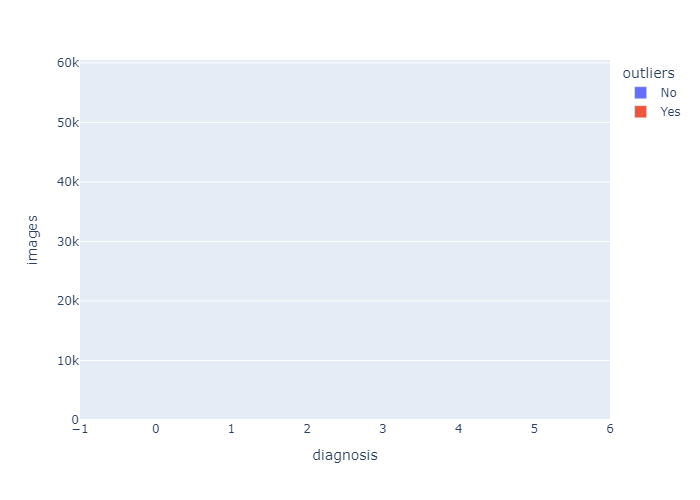

In [28]:
df_outlier_.rename(columns = {0:'path'}, inplace = True)
df_outlier_['diagnosis'] = df_diagnosis_t
df_outlier_['target'] = df_target_t

fig = px.bar(df_temporal, x='diagnosis', y='images', color='outliers', height=500, text='images')
fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
fig.show()

In [35]:
df_outlier_.to_csv("results/train_outliers.csv", index=False)

In [36]:
test_df=pd.read_csv("results/train_outliers.csv")
test_df

,path,Diagnosis,target,diagnosis
0,content/2019/train/ISIC_0000220.jpg,NV,5.0,NV
1,content/2019/train/ISIC_0000492.jpg,NV,5.0,NV
2,content/2019/train/ISIC_0003728_downsampled.jpg,NV,5.0,NV
3,content/2019/train/ISIC_0010177.jpg,NV,5.0,NV
4,content/2019/train/ISIC_0010339.jpg,NV,5.0,NV
...,...,...,...,...
10815,content/2020/train/ISIC_9996662.jpg,UNK,7.0,UNK
10816,content/2020/train/ISIC_9998152.jpg,UNK,7.0,UNK
10817,content/2020/train/ISIC_9998240.jpg,UNK,7.0,UNK
10818,content/2020/train/ISIC_9999127.jpg,UNK,7.0,UNK


In [37]:
#df_class['image'] = df_class['image_name']
df_class['image_name'] = df_class['image']

In [40]:
# test
df_temporal = pd.DataFrame(columns = ['images', 'outliers'])
df_outlier_ = pd.DataFrame()
df_diagnosis_t = pd.DataFrame()
df_target_t = pd.DataFrame()

df_class  = df
print('Images for class '+class_name +' '+str(len(df_class)))
outliers_ = df_class[df_class['mean_norm'].between(0.48,0.88,inclusive='both')]
outliers_ = df_class[~df_class['image'].isin(outliers_['image'])]
print('Outliers: '+str(len(outliers_))+'\n') 
df_outlier_ = pd.concat([df_outlier_,outliers_['path']], ignore_index=True)
df_diagnosis_t = pd.concat([df_diagnosis_t,outliers_['diagnosis']], ignore_index=True)
df_target_t = pd.concat([df_target_t,outliers_['target']], ignore_index=True)
df_outlier_.loc[idx,'diagnosis'] = class_name

df_temporal = pd.concat([df_temporal, pd.DataFrame([{'images': len(df_class)-len(outliers_), 'outliers': 'No'}])], ignore_index=True)
df_temporal = pd.concat([df_temporal, pd.DataFrame([{'images': len(outliers_), 'outliers': 'Yes'}])], ignore_index=True)


df_outlier_.rename(columns = {0:'path'}, inplace = True)
df_outlier_['diagnosis'] = df_diagnosis_t
df_outlier_['target'] = df_target_t

Images for class UNK 57459
Outliers: 5865



In [41]:
outliers_.shape

(5865, 17)

In [42]:
df_temporal

,images,outliers
0,51594,No
1,5865,Yes


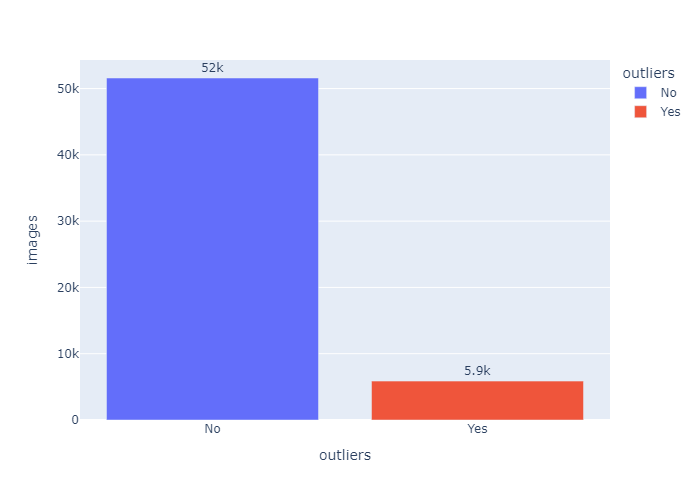

In [43]:
import plotly.express as px
fig = px.bar(df_temporal, x='outliers', y='images', color='outliers', height=500, text='images')
fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
fig.show()

In [44]:
df_outlier_.to_csv("results/test_outliers.csv", index=False)

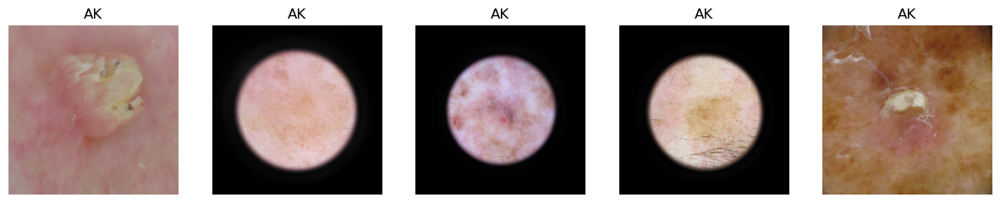

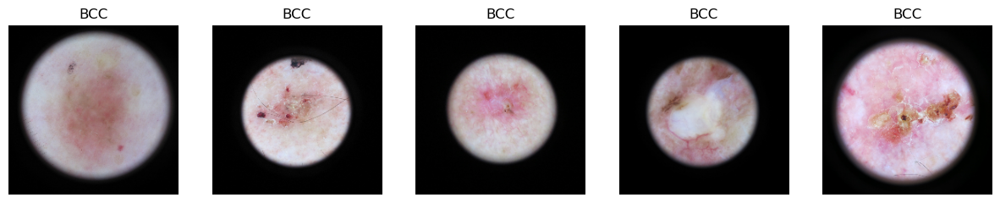

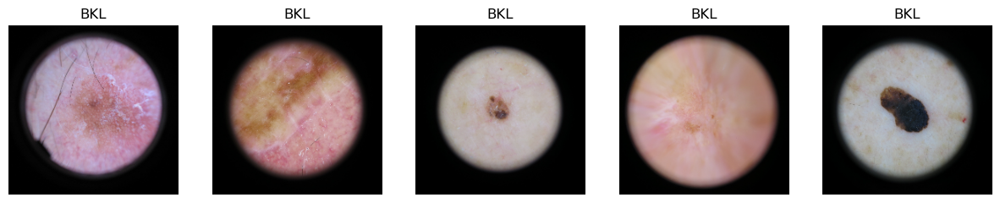

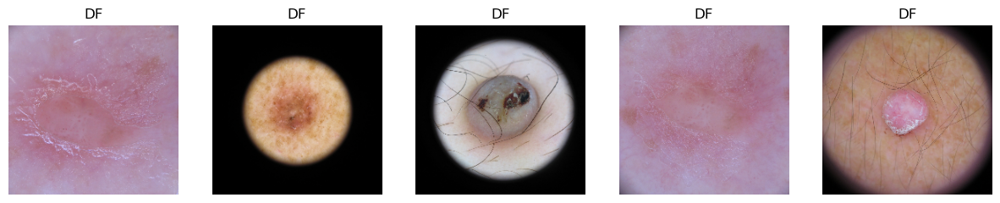

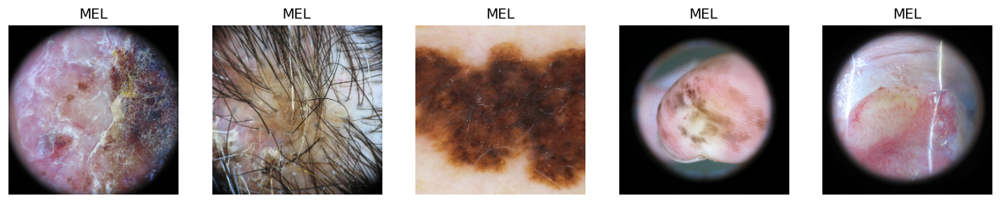

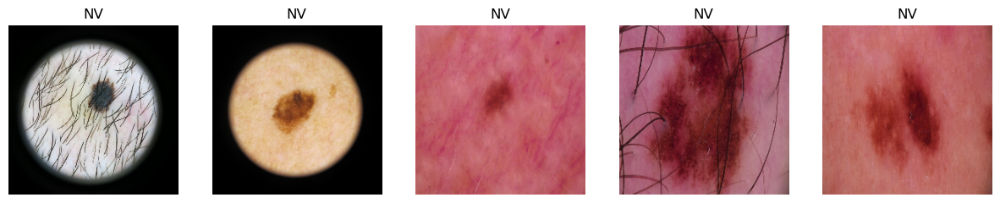

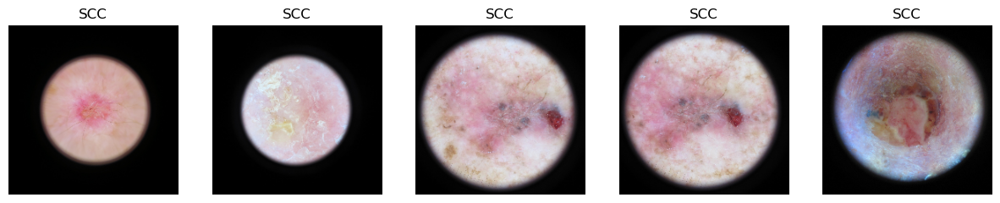

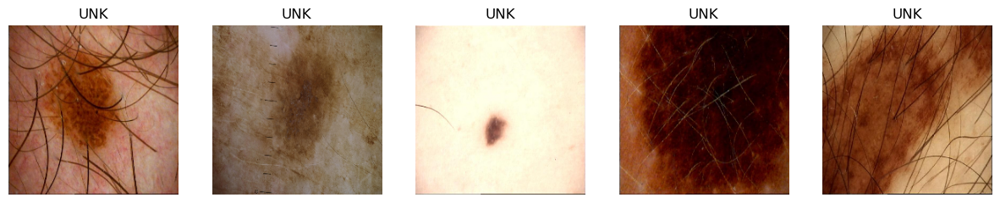

In [47]:
for i in range(8):
  visualize_images(df_outlier_,i, row_col=(1,5), figsize= (15,15))

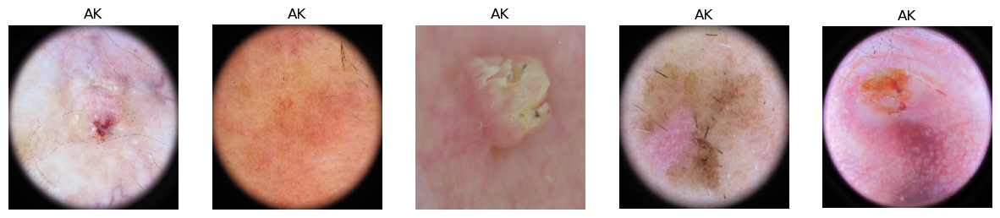

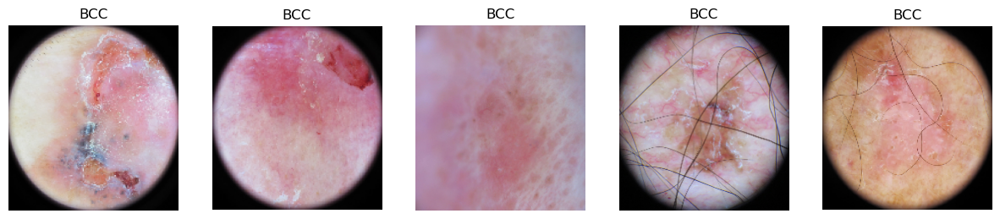

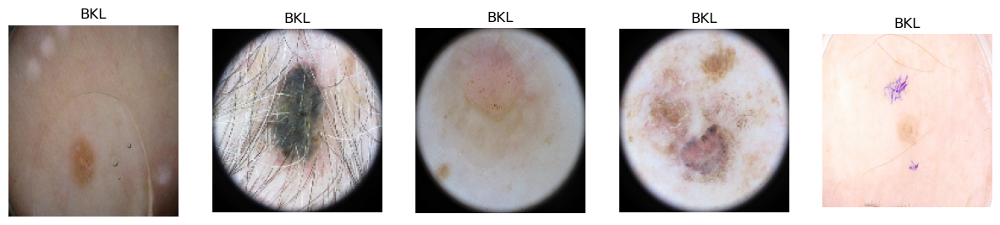

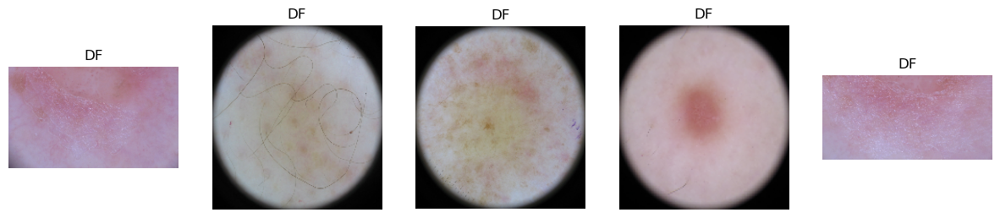

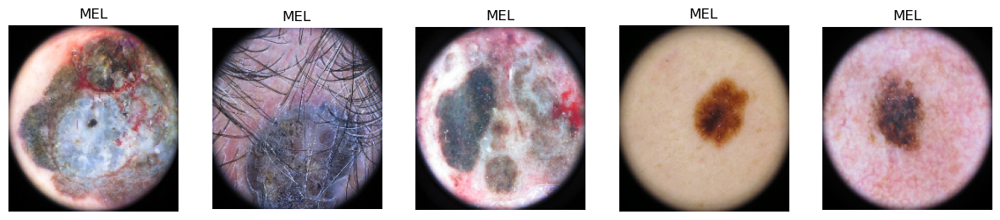

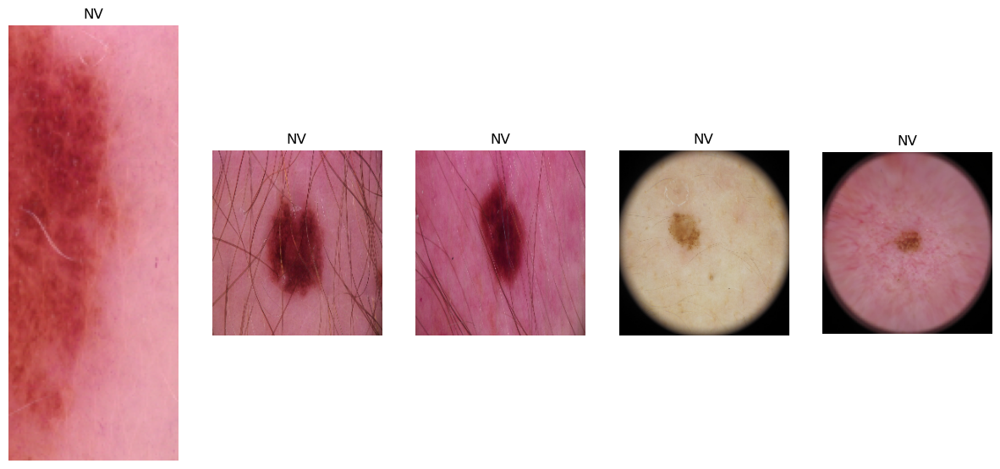

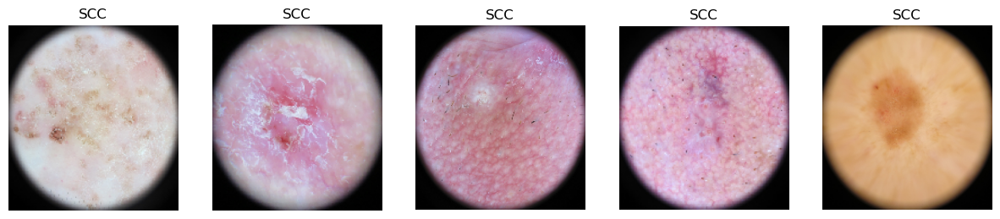

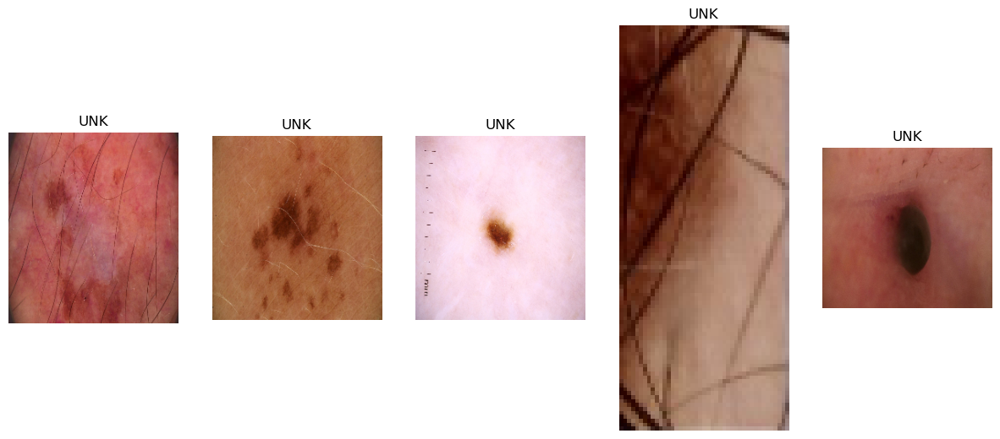

In [52]:
for i in range(8):
  visualize_images(df_outlier_,i, row_col=(1,5), figsize= (15,15), microscopy_crop = True)

In [53]:
df_outlier_.shape

(5865, 3)

In [54]:
import pandas as pd
df_outlier_ = pd.read_csv("results/test_outliers.csv").reset_index(drop=True)

In [55]:
import random
import matplotlib.pyplot as plt
import numpy as np
import cv2
def visualize_images_test(df, row_col=(4,4), figsize=(12,12), microscopy_crop=False):
  plt.figure(figsize=figsize)
  plt.tight_layout
  p = np.array(df.loc[:,'path'])
  row, col = row_col
  r=500
  for k in range(row*col):
    try:
      # r = np.random.randint(len(p)-1)
      r = r+1
    except:
      continue
    i = p[r]
    img = cv2.imread(i); 
    # img = cv2.resize(img, (224,244))
    if r == 600:
      break
    if microscopy_crop:
      img = crop_microscopy(img)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  
    plt.subplot(row,col,k+1); plt.imshow(img/255.)
    plt.axis("off")
    # plt.title(p[r], fontsize=12); plt.axis("off")

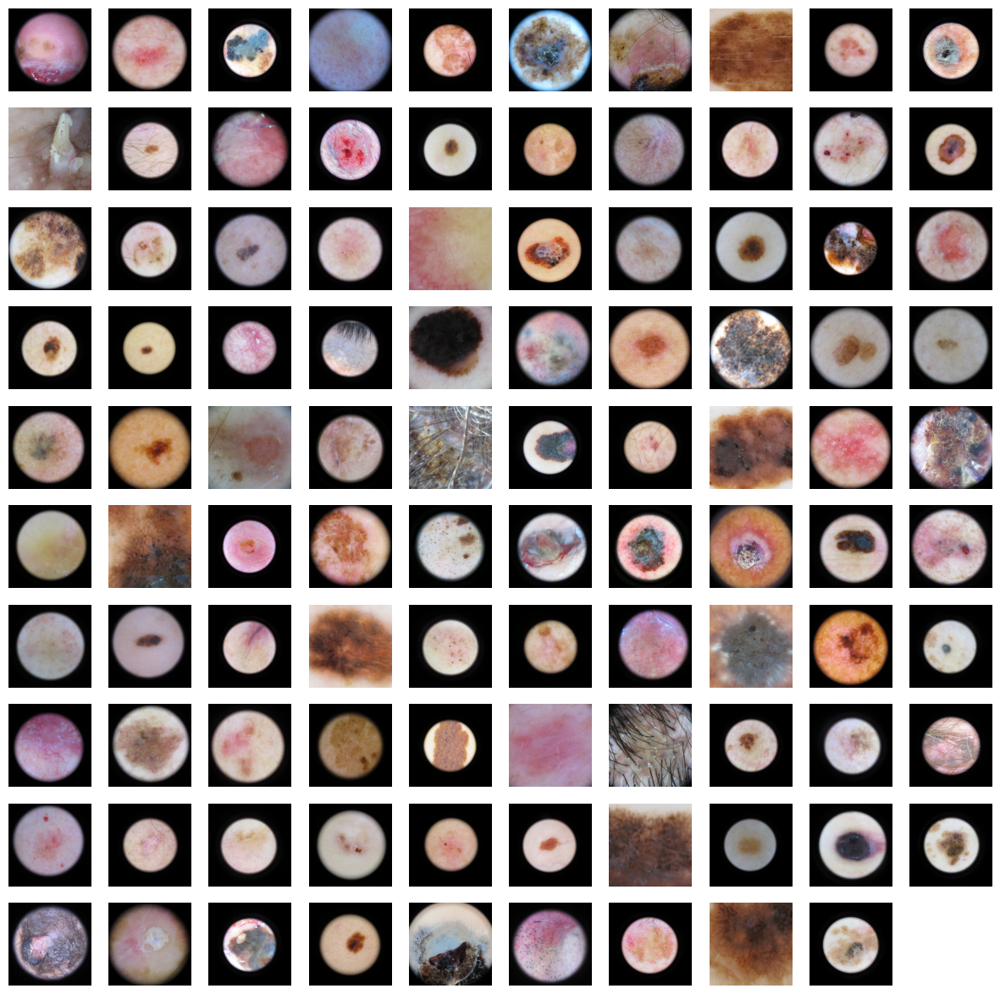

In [56]:
visualize_images_test(df_outlier_,row_col=(10,10), figsize= (15,15), microscopy_crop = False)

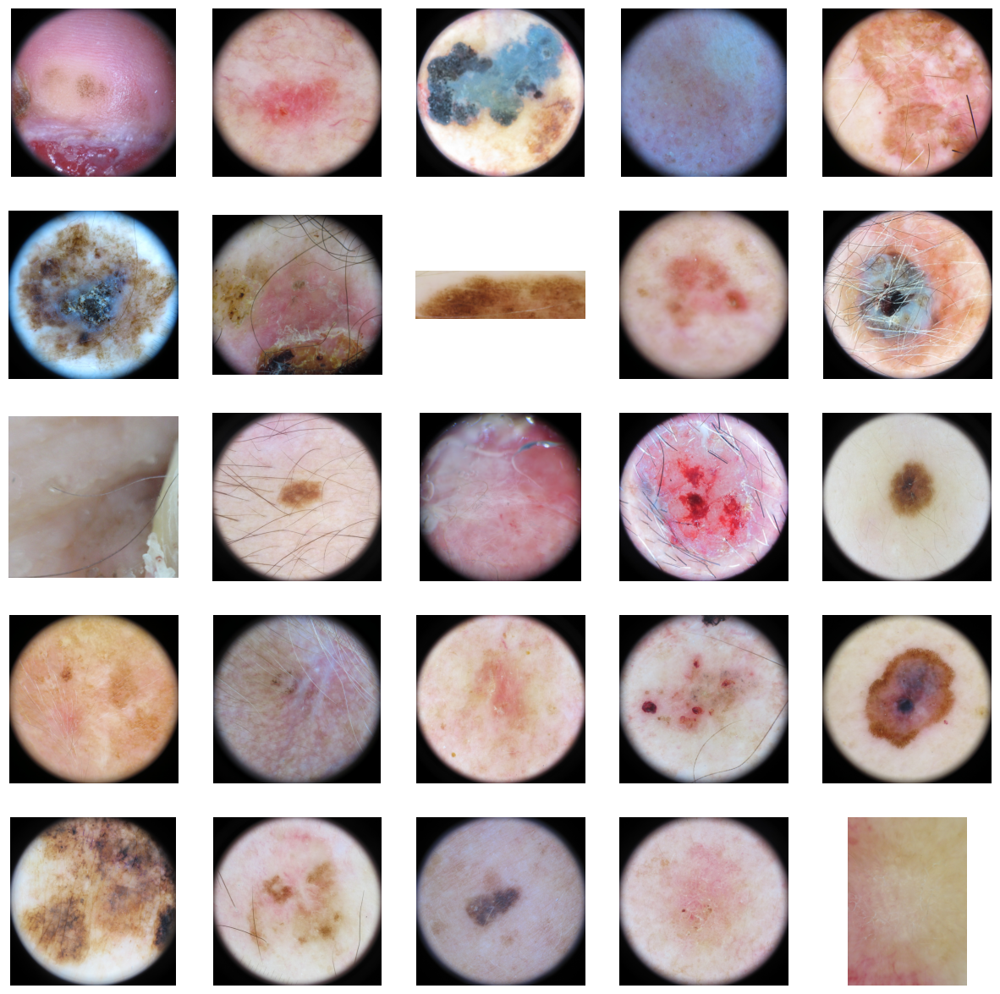

In [57]:
visualize_images_test(df_outlier_,row_col=(5,5), figsize= (15,15), microscopy_crop = True)

In [58]:
df_outlier_.shape

(5865, 3)

# Feature extractor


## Dataset & Dataloader

In [59]:
df = pd.read_csv("results/test_outliers.csv").reset_index(drop=True)

In [63]:
import torch
import albumentations as A

class Load_Dataset(torch.utils.data.Dataset):
    def __init__(self,df):
        self.image_paths = df['path']
        self.labels = df['target']
        self.default_transform = A.Compose([
            A.Normalize((0.6670, 0.5290, 0.5240),
                      (0.2239, 0.2037, 0.2155),always_apply=True),
            A.Resize(224,224),
        ])
        
    def __len__(self):
        return self.image_paths.shape[0]
    
    def __getitem__(self,idx):
        img_path = self.image_paths[idx]
        image = cv2.cvtColor(cv2.imread(img_path),cv2.COLOR_BGR2RGB)
        image = self.default_transform(image=image)['image']        
        image = image.transpose(2, 0, 1)
        image = torch.tensor(image).float()
        label = torch.tensor(self.labels[idx])

        return image,label

In [61]:
!conda install ipywidgets widgetsnbextension pandas-profiling

^C


In [64]:
!conda list ipywidgets

^C
# packages in environment at D:\FINAL_PROJECT\conda_files\envs\pjt:
#
# Name                    Version                   Build  Channel
ipywidgets                8.1.5           py312haa95532_0  


In [67]:
from torchvision import models
from tqdm.notebook import tqdm
import torch
import numpy as np

# Check if GPU is available
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f"Using device: {device}")

# Load dataset
train_data = Load_Dataset(df)  
train_loader = torch.utils.data.DataLoader(train_data, batch_size=128)

# Load VGG19 model
vgg_m = models.vgg19(weights=models.VGG19_Weights.IMAGENET1K_V1)  # Use 'weights' instead of 'pretrained'
vgg_m.classifier = torch.nn.Sequential(vgg_m.classifier[0])

# Move model to GPU if available
vgg_m.to(device)
print("✅ Model loaded and moved to device.")

output_descriptor = np.zeros((1, 4096))
output_label = np.zeros((1))

# Run inference
vgg_m.eval()
with torch.no_grad():
    for i, (images, labels) in enumerate(tqdm(train_loader)):
        print(f"Processing batch {i+1}/{len(train_loader)}...")  # Debugging print

        images, labels = images.to(device), labels.to(device)
        pred = vgg_m(images)

        output_descriptor = np.concatenate((output_descriptor, pred.cpu().numpy().squeeze()), 0)
        output_label = np.concatenate((output_label, labels.cpu().numpy()))

output_descriptor = output_descriptor[1:]
output_label = output_label[1:]

print("✅ Processing complete!")


Using device: cuda
✅ Model loaded and moved to device.


  0%|          | 0/46 [00:00<?, ?it/s]

Processing batch 1/46...
Processing batch 2/46...
Processing batch 3/46...
Processing batch 4/46...
Processing batch 5/46...
Processing batch 6/46...
Processing batch 7/46...
Processing batch 8/46...
Processing batch 9/46...
Processing batch 10/46...
Processing batch 11/46...
Processing batch 12/46...
Processing batch 13/46...
Processing batch 14/46...
Processing batch 15/46...
Processing batch 16/46...
Processing batch 17/46...
Processing batch 18/46...
Processing batch 19/46...
Processing batch 20/46...
Processing batch 21/46...
Processing batch 22/46...
Processing batch 23/46...
Processing batch 24/46...
Processing batch 25/46...
Processing batch 26/46...
Processing batch 27/46...
Processing batch 28/46...
Processing batch 29/46...
Processing batch 30/46...
Processing batch 31/46...
Processing batch 32/46...
Processing batch 33/46...
Processing batch 34/46...
Processing batch 35/46...
Processing batch 36/46...
Processing batch 37/46...
Processing batch 38/46...
Processing batch 39/4

In [65]:
from torchvision import models
from tqdm.notebook import tqdm
#Load dataset
train_data = Load_Dataset(df)
train_loader = torch.utils.data.DataLoader(train_data,batch_size=128)

#loading pretrained model for vgg19
vgg_m = models.vgg19(pretrained=True)
#taking only the first layer from classifier (4096)
vgg_m.classifier = torch.nn.Sequential(vgg_m.classifier[0])
output_descriptor = np.zeros((1,4096))
output_label = np.zeros((1))
device = 'cuda'
vgg_m.to(device)
with torch.no_grad():
    for _, (images,labels) in tqdm(enumerate(train_loader)):
        images,labels = images.to(device),labels.to(device)
        #evaluating the image with pretrained model
        vgg_m.eval()
        pred = vgg_m(images)
        #concatenating all the outputs and labels as a batch of 128 and store in a variable
        output_descriptor =np.concatenate((output_descriptor,pred.cpu().numpy().squeeze()),0)
        output_label = np.concatenate((output_label,labels.cpu().numpy()))
output_descriptor = output_descriptor[1:]
output_label = output_label[1:]

D:\FINAL_PROJECT\conda_files\envs\pjt\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning:

The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.

D:\FINAL_PROJECT\conda_files\envs\pjt\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning:

Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.



0it [00:00, ?it/s]

KeyboardInterrupt: 

In [68]:
from numpy import savetxt
#output_label
savetxt('output_label', output_label, delimiter=',')

In [69]:
# output_descriptor
savetxt('output_descriptor', output_descriptor, delimiter=',')

In [ ]:
# !cp output_descriptor.csv /content/drive/MyDrive/ISIC/Descriptors/
# !cp output_descriptor /content/drive/MyDrive/ISIC/Descriptors/
# !cp output_label.csv /content/drive/MyDrive/ISIC/Descriptors/
# !cp output_label.csv /content/drive/MyDrive/ISIC/Descriptors/

## PCA

In [70]:
import time
from sklearn.decomposition import PCA
st_time = time.time()
#extracting top principal component features
pca = PCA(n_components=3)
pca_result_train = pca.fit_transform(output_descriptor)

print('PCA done; Time take {} seconds'.format(time.time()-st_time))
print('Variance: {}'.format(pca.explained_variance_ratio_))
print('Sum of variance in data by first top ten components: {:.2f}%'.format(100*(pca.explained_variance_ratio_.sum())))

##PCA df
pca_tr = pd.DataFrame()
for idx in range(pca_result_train.shape[1]):
    pca_tr['pca'+str(idx+1)] = pca_result_train[:,idx]

pca_tr['target'] = output_label.astype(int)
# pca_tr['diagnosis'] = pca_tr['target'].apply(lambda x: disease_names[str(x)])
pca_tr.head()

PCA done; Time take 0.6678123474121094 seconds
Variance: [0.34754605 0.10529189 0.07096482]
Sum of variance in data by first top ten components: 52.38%


,pca1,pca2,pca3,target
0,-54.199886,1.242566,-9.049845,4
1,-69.736718,-0.807382,-1.577182,4
2,-60.231120,-2.492557,-6.341453,5
3,72.581298,-43.745441,19.593863,5
4,-87.346171,-7.985579,7.486919,5


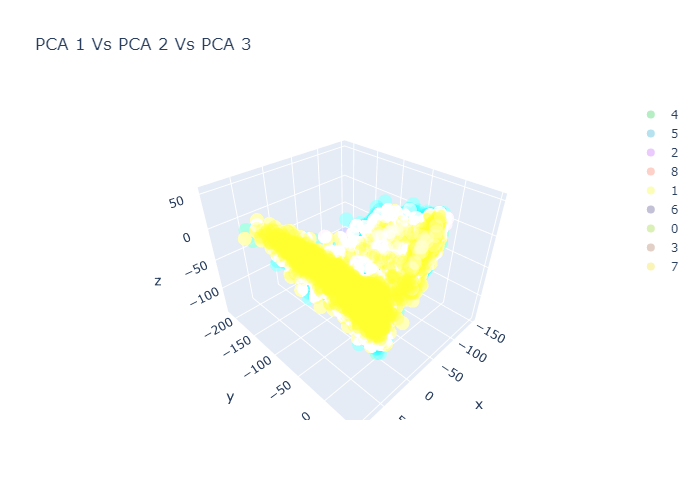

In [75]:
import plotly.graph_objects as go
fig = go.Figure()
colors = ['rgba(13, 200, 58, 0.3)','rgba(13, 160, 200, 0.3)','rgba(190, 81, 249, 0.3)','rgba(248, 104, 73, 0.3)','rgba(243, 247, 15, 0.3)','rgba(53, 51, 120, 0.3)','rgba(136, 206, 14, 0.3)','rgba(159, 96, 67, 0.3)','rgba(237, 218, 14, 0.3)']
for idx,dn in enumerate(pca_tr['target'].unique()):
    df = pca_tr[pca_tr['target'] == dn]
    fig.add_trace(go.Scatter3d(x=df['pca1'],y=df['pca2'],z=df['pca3'],mode='markers',marker_color = colors[idx],name=str(dn)))
    # fig.add_trace(go.scatter(x=df['pca1'],y=df['pca2'],mode='markers',marker_color = colors[idx],name=str(dn)))
fig.update_layout(title='PCA 1 Vs PCA 2 Vs PCA 3')
fig.show()

In [72]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
sns.set(style='white', context='notebook', rc={'figure.figsize':(14,10)})
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

In [73]:
df_ = pd.read_csv(f'results/train_whole_no_duplicates.csv').reset_index(drop=True)
df_val = pd.read_csv(f'results/val_whole_no_duplicates.csv').reset_index(drop=True)

## T-SNE

In [76]:
from sklearn.manifold import TSNE
st_time = time.time()
t_sne = TSNE(random_state=2020)
t_sne_tr = t_sne.fit_transform(output_descriptor)
print('TNSE done; Time take {} seconds'.format(time.time()-st_time))



TNSE done; Time take 18.21565270423889 seconds


In [77]:
##T-SNE df
tsne_tr = pd.DataFrame()
for idx in range(t_sne_tr.shape[1]):
    tsne_tr['t_sne'+str(idx+1)] = t_sne_tr[:,idx]
tsne_tr['label'] = output_label.astype(int)
# tsne_tr['disease_name'] = tsne_tr['label'].apply(lambda x: disease_names[str(x)])
tsne_tr.head()

,t_sne1,t_sne2,label
0,-31.275438,28.226315,4
1,-61.167290,-0.010138,4
2,-29.572920,-2.270873,5
3,36.193295,-36.261433,5
4,-59.428768,-2.293239,5


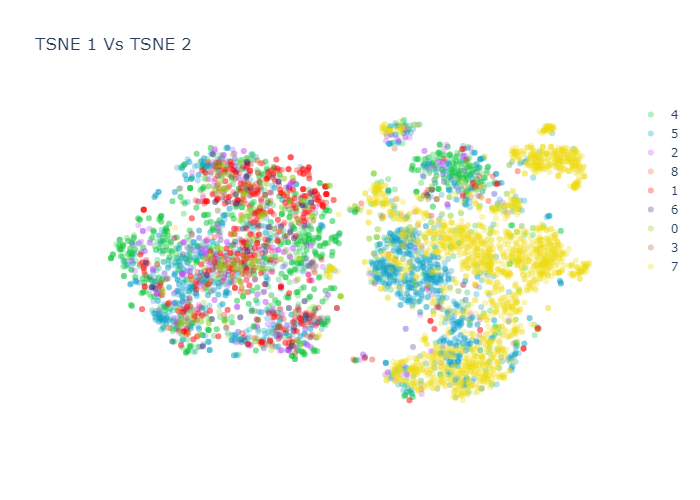

In [80]:
layout = {
    # 'showlegend': False,
    'xaxis': {
        'showgrid': False
        },
    'yaxis': {
      'showgrid': False,
      'showline': True
        },
    'plot_bgcolor':'rgb(255,255,255)'
    # 'paper_bgcolor':'rgb(0,0,0)',
}

fig = go.Figure(layout=layout)
colors = ['rgba(13, 200, 58, 0.3)','rgba(13, 160, 200, 0.3)','rgba(190, 81, 249, 0.3)','rgba(248, 104, 73, 0.3)','rgba(255, 0, 0, 0.3)','rgba(53, 51, 120, 0.3)','rgba(136, 206, 14, 0.3)','rgba(159, 96, 67, 0.3)','rgba(237, 218, 14, 0.3)']
for idx,dn in enumerate(tsne_tr['label'].unique()):
    df = tsne_tr[tsne_tr['label'] == dn]
    fig.add_trace(go.Scatter(x=df['t_sne1'],y=df['t_sne2'],mode='markers',marker_color = colors[idx],name=str(dn)))

#fig.update_layout(paper_bgcolor="rgb(0,0,0,0)")
fig.update_xaxes(visible=False)
fig.update_yaxes(visible=False)
fig.update_layout(title='TSNE 1 Vs TSNE 2')
fig.update_xaxes(title_text="TSNE_1")
fig.update_yaxes(title_text="TSNE_2")
fig.show()

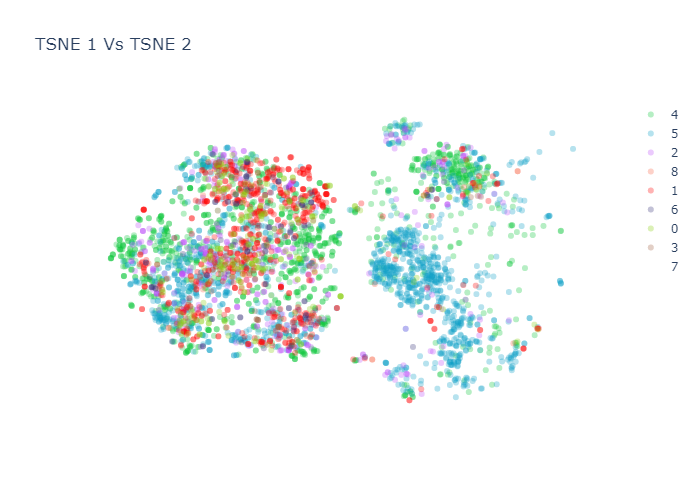

In [81]:
layout = {
    # 'showlegend': False,
    'xaxis': {
        'showgrid': False
        },
    'yaxis': {
      'showgrid': False,
      'showline': True
        },
    'plot_bgcolor':'rgb(255,255,255)'
    # 'paper_bgcolor':'rgb(0,0,0)',
}

fig = go.Figure(layout=layout)
colors = ['rgba(13, 200, 58, 0.3)','rgba(13, 160, 200, 0.3)','rgba(190, 81, 249, 0.3)','rgba(248, 104, 73, 0.3)','rgba(255, 0, 0, 0.3)','rgba(53, 51, 120, 0.3)','rgba(136, 206, 14, 0.3)','rgba(159, 96, 67, 0.3)','rgba(237, 218, 14, 0.0)']
for idx,dn in enumerate(tsne_tr['label'].unique()):
    df = tsne_tr[tsne_tr['label'] == dn]
    fig.add_trace(go.Scatter(x=df['t_sne1'],y=df['t_sne2'],mode='markers',marker_color = colors[idx],name=str(dn)))

# fig.update_layout(paper_bgcolor="rgb(0,0,0,0)")
fig.update_xaxes(visible=False)
fig.update_yaxes(visible=False)
fig.update_layout(title='TSNE 1 Vs TSNE 2')
fig.update_xaxes(title_text="TSNE_1")
fig.update_yaxes(title_text="TSNE_2")
fig.show()

In [82]:
st_time = time.time()
t_sne = TSNE(random_state=2022, perplexity=5, learning_rate=300)
t_sne_tr = t_sne.fit_transform(output_descriptor)
print('TNSE done; Time take {} seconds'.format(time.time()-st_time))

TNSE done; Time take 13.873599767684937 seconds


In [83]:
##T-SNE df
tsne_tr = pd.DataFrame()
for idx in range(t_sne_tr.shape[1]):
    tsne_tr['t_sne'+str(idx+1)] = t_sne_tr[:,idx]
tsne_tr['label'] = output_label.astype(int)
# tsne_tr['disease_name'] = tsne_tr['label'].apply(lambda x: disease_names[str(x)])
tsne_tr.head()

,t_sne1,t_sne2,label
0,-24.158251,43.960613,4
1,-75.456940,-17.674030,4
2,-33.004387,4.016916,5
3,22.294397,-50.637882,5
4,-76.235077,-27.558998,5


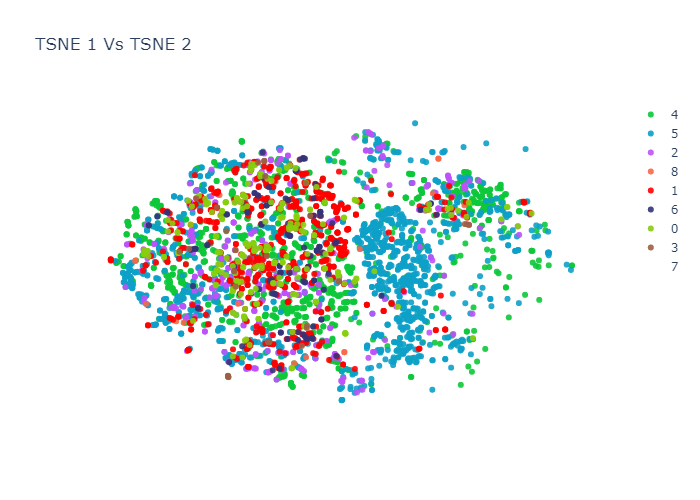

In [85]:
layout = {
    # 'showlegend': False,
    'xaxis': {
        'showgrid': False
        },
    'yaxis': {
      'showgrid': False,
      'showline': True
        },
    'plot_bgcolor':'rgb(255,255,255)'
    # 'paper_bgcolor':'rgb(0,0,0)',
}

fig = go.Figure(layout=layout)
colors = ['rgba(13, 200, 58, 0.9)','rgba(13, 160, 200, 0.9)','rgba(190, 81, 249, 0.9)','rgba(248, 104, 73, 0.9)','rgba(255, 0, 0, 0.9)','rgba(53, 51, 120, 0.9)','rgba(136, 206, 14, 0.9)','rgba(159, 96, 67, 0.9)','rgba(237, 218, 14, 0.0)']
for idx,dn in enumerate(tsne_tr['label'].unique()):
    df = tsne_tr[tsne_tr['label'] == dn]
    fig.add_trace(go.Scatter(x=df['t_sne1'],y=df['t_sne2'],mode='markers',marker_color = colors[idx],name=str(dn)))

# fig.update_layout(paper_bgcolor="rgb(0,0,0,0)")
fig.update_xaxes(visible=False)
fig.update_yaxes(visible=False)
fig.update_layout(title='TSNE 1 Vs TSNE 2')
fig.update_xaxes(title_text="TSNE_1")
fig.update_yaxes(title_text="TSNE_2")
fig.show()

# Meta data




Adapted from:
@[MEKHDI GAKHRAMANIAN](https://www.kaggle.com/code/mekhdigakhramanian/siim-eda-stacking-top8-0-96)

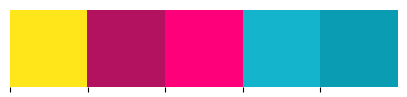

In [1]:
import pandas as pd
import numpy as np

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import io
import plotly.offline as py#visualization
py.init_notebook_mode(connected=True)#visualization
import plotly.graph_objs as go#visualization
import plotly.tools as tls#visualization
import plotly.figure_factory as ff#visualization

import seaborn as sns
import plotly.express as px

# import pydicom # for DICOM images
from skimage.transform import resize

# SKLearn
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder

import os
import random
import re
import math
import time
from IPython.display import display_html
import missingno as msno 
import gc
import cv2
import matplotlib.image as mpimg

# Set Color Palettes for the notebook (https://color.adobe.com/)
colors_nude = ['#FFE61A','#B2125F','#FF007B','#14B4CC','#099CB3']
sns.palplot(sns.color_palette(colors_nude))

# Set Style
sns.set_style("whitegrid")
sns.despine(left=True, bottom=True)


import warnings

warnings.filterwarnings('ignore') # Disabling warnings for clearer outputs


seed_val = 42
random.seed(seed_val)
np.random.seed(seed_val)

In [2]:
train = pd.read_csv(f'results/whole_data_no_duplicates.csv').reset_index(drop=True)
train

,image,path,diagnosis,age_approx,anatom_site_general,sex,target,temporal_image
0,ISIC_0000000,content/2019/train/ISIC_0000000.jpg,NV,55.0,anterior torso,female,5,ISIC_0000000.jpg
1,ISIC_0000001,content/2019/train/ISIC_0000001.jpg,NV,30.0,anterior torso,female,5,ISIC_0000001.jpg
2,ISIC_0000002,content/2019/train/ISIC_0000002.jpg,MEL,60.0,upper extremity,female,4,ISIC_0000002.jpg
3,ISIC_0000003,content/2019/train/ISIC_0000003.jpg,NV,30.0,upper extremity,male,5,ISIC_0000003.jpg
4,ISIC_0000004,content/2019/train/ISIC_0000004.jpg,MEL,80.0,posterior torso,male,4,ISIC_0000004.jpg
...,...,...,...,...,...,...,...,...
65259,NaN,content/2019/med-node/naevus/458192.jpg,NV,NaN,NaN,NaN,5,NaN
65260,NaN,content/2019/med-node/naevus/497621.jpg,NV,NaN,NaN,NaN,5,NaN
65261,NaN,content/2019/med-node/naevus/499701.jpg,NV,NaN,NaN,NaN,5,NaN
65262,NaN,content/2019/med-node/naevus/515125.jpg,NV,NaN,NaN,NaN,5,NaN


In [3]:
test_2 = pd.read_csv(f"content/2020/test/ISIC_2020_Test_Metadata.csv").reset_index(drop=True)
test_2

,image,patient,age_approx,anatom_site_general,sex
0,ISIC_0052060,IP_3579794,70,NaN,male
1,ISIC_0052349,IP_7782715,40,lower extremity,male
2,ISIC_0058510,IP_7960270,55,torso,female
3,ISIC_0073313,IP_6375035,50,torso,female
4,ISIC_0073502,IP_0589375,45,lower extremity,female
...,...,...,...,...,...
10977,ISIC_9992485,IP_4152479,40,torso,male
10978,ISIC_9996992,IP_4890115,35,torso,male
10979,ISIC_9997917,IP_2852390,25,upper extremity,male
10980,ISIC_9998234,IP_8861963,65,lower extremity,male


In [4]:
test = pd.read_csv(f"content/2019/test/ISIC_2019_Test_Metadata.csv").reset_index(drop=True)
test

,image,age_approx,anatom_site_general,sex
0,ISIC_0034321,60.0,NaN,female
1,ISIC_0034322,70.0,anterior torso,male
2,ISIC_0034323,70.0,lower extremity,male
3,ISIC_0034324,70.0,lower extremity,male
4,ISIC_0034325,30.0,upper extremity,female
...,...,...,...,...
8233,ISIC_0073236,75.0,anterior torso,male
8234,ISIC_0073243,65.0,lower extremity,male
8235,ISIC_0073250,30.0,anterior torso,female
8236,ISIC_0073252,85.0,head/neck,female


In [5]:
#train = train.drop(train.columns[[1, 6, 7]], axis=1)  
#test = test.drop(test.columns[[4]], axis=1)  

#test_2 = test_2.drop(test_2.columns[[1]], axis=1)  

In [6]:
# checking column names
print(
    f'Train data has {train.shape[1]} features, {train.shape[0]} observations and Test data {test.shape[1]} features, {test.shape[0]} observations.\nTrain features are:\n{train.columns.tolist()}\nTest features are:\n{test.columns.tolist()}'
)

print(
    f'Train data has {train.shape[1]} features, {train.shape[0]} observations and Test data {test_2.shape[1]} features, {test_2.shape[0]} observations.\nTrain features are:\n{train.columns.tolist()}\nTest features are:\n{test_2.columns.tolist()}'
)

Train data has 8 features, 65264 observations and Test data 4 features, 8238 observations.
Train features are:
['image', 'path', 'diagnosis', 'age_approx', 'anatom_site_general', 'sex', 'target', 'temporal_image']
Test features are:
['image', 'age_approx', 'anatom_site_general', 'sex']
Train data has 8 features, 65264 observations and Test data 5 features, 10982 observations.
Train features are:
['image', 'path', 'diagnosis', 'age_approx', 'anatom_site_general', 'sex', 'target', 'temporal_image']
Test features are:
['image', 'patient', 'age_approx', 'anatom_site_general', 'sex']


In [7]:
train_df = train.copy()
test_df = test.copy()

test2_df = test_2.copy()

In [8]:
#train.columns = [    'image', 'diagnosis', 'sex', 'age', 'location',]

#test.columns = ['image','sex', 'age', 'location']

#test_2.columns = ['image','age', 'location', 'sex']

In [ ]:
train_df = train.copy()
test_df = test.copy()

test2_df = test_2.copy()
df1_styler = train_df.head().style.set_table_attributes("style='display:inline'").set_caption('Head Train Data')
df2_styler = test_df.head().style.set_table_attributes("style='display:inline'").set_caption('Head Test Data')

df2_styler = test2_df.head().style.set_table_attributes("style='display:inline'").set_caption('Head Test Data')

display_html(df1_styler._repr_html_() + df2_styler._repr_html_(), raw=True)

Head Train Data 
 
 
   
 image 
 diagnosis 
 sex 
 age 
 location 
 
 
 
 
 0 
 ISIC_0000000 
 NV 
 55.000000 
 female 
 anterior torso 
 
 
 1 
 ISIC_0000001 
 NV 
 30.000000 
 female 
 anterior torso 
 
 
 2 
 ISIC_0000002 
 MEL 
 60.000000 
 female 
 upper extremity 
 
 
 3 
 ISIC_0000003 
 NV 
 30.000000 
 male 
 upper extremity 
 
 
 4 
 ISIC_0000004 
 MEL 
 80.000000 
 male 
 posterior torso 
 
 
 

 
 Head Test Data 
 
 
   
 image 
 age 
 location 
 sex 
 
 
 
 
 0 
 ISIC_0052060 
 70 
 nan 
 male 
 
 
 1 
 ISIC_0052349 
 40 
 lower extremity 
 male 
 
 
 2 
 ISIC_0058510 
 55 
 torso 
 female 
 
 
 3 
 ISIC_0073313 
 50 
 torso 
 female 
 
 
 4 
 ISIC_0073502 
 45 
 lower extremity 
 female

# Check missing values

In [9]:
test2_df

,image,patient,age_approx,anatom_site_general,sex
0,ISIC_0052060,IP_3579794,70,NaN,male
1,ISIC_0052349,IP_7782715,40,lower extremity,male
2,ISIC_0058510,IP_7960270,55,torso,female
3,ISIC_0073313,IP_6375035,50,torso,female
4,ISIC_0073502,IP_0589375,45,lower extremity,female
...,...,...,...,...,...
10977,ISIC_9992485,IP_4152479,40,torso,male
10978,ISIC_9996992,IP_4890115,35,torso,male
10979,ISIC_9997917,IP_2852390,25,upper extremity,male
10980,ISIC_9998234,IP_8861963,65,lower extremity,male


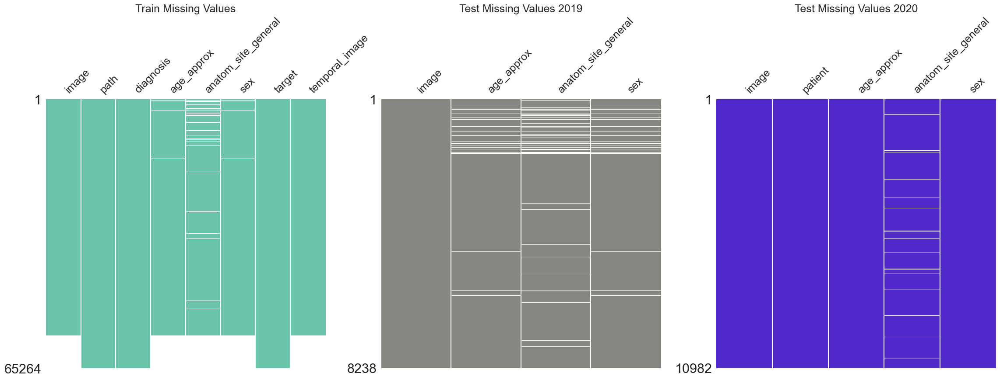

In [10]:
f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize = (28,8))

size_ = 18 
msno.matrix(train_df, ax = ax1, color=(107/255, 196/255, 171/255), fontsize=size_)
msno.matrix(test_df, ax = ax2, color=(136/255, 136/255, 130/255), fontsize=size_)
msno.matrix(test2_df, ax = ax3, color=(80/255, 40/255, 200/255), fontsize=size_)

ax1.set_title('Train Missing Values', fontsize = size_)
ax2.set_title('Test Missing Values 2019', fontsize = size_);
ax3.set_title('Test Missing Values 2020', fontsize = size_);

# Sunburstt

In [29]:
df_temporal

,diagnosis,images,outliers,Diagnosis
0,NaN,17627,No,NV
1,NaN,323,Yes,NV
2,NaN,3383,No,MEL
3,NaN,1668,Yes,MEL
4,NaN,2668,No,BKL
5,NaN,138,Yes,BKL
6,NaN,149,No,DF
7,NaN,90,Yes,DF
8,NaN,542,No,SCC
9,NaN,86,Yes,SCC


In [38]:
fig = px.sunburst(data_frame=df_temporal,
                  path=['diagnosis','images'],
                  color='diagnosis',
                  # color_discrete_sequence=colors_nude,
                  maxdepth=-1,
                  title='Sunburst Chart Anatomical location vs Age')

fig.update_traces(textinfo='label+percent parent')
fig.update_layout(margin=dict(t=50, l=0, r=0, b=0))
fig.show()

ValueError: ('None entries cannot have not-None children', ('nan', '58'))

In [ ]:
# Filling missing  values with 'unknown' and '-1' tags:

for df in [train, test]:
    df['location'].fillna('unknown', inplace=True)
    
train['sex'].fillna('unknown', inplace=True)

train['age'].fillna(-1, inplace=True)

In [ ]:

# Plotting interactive sunburst:

fig = px.sunburst(data_frame=train,
                  path=['diagnosis','age'],
                  color='diagnosis',
                  # color_discrete_sequence=colors_nude,
                  maxdepth=-1,
                  title='Sunburst Chart Anatomical location vs Age')

fig.update_traces(textinfo='label+percent parent')
fig.update_layout(margin=dict(t=50, l=0, r=0, b=0))
fig.show(renderer="colab")

In [ ]:

# Plotting interactive sunburst:

fig = px.sunburst(data_frame=train,
                  path=['location','age'],
                  color='location',
                  # color_discrete_sequence=colors_nude,
                  maxdepth=-1,
                  title='Sunburst Chart Anatomical location vs Age')

fig.update_traces(textinfo='label+percent parent')
fig.update_layout(margin=dict(t=50, l=0, r=0, b=0))
fig.show(renderer="colab")

# Anatomy and Diagnosis

In [31]:
train_df.shape

(65264, 8)

In [39]:
train_df

,image,path,diagnosis,age_approx,anatom_site_general,sex,target,temporal_image
0,ISIC_0000000,content/2019/train/ISIC_0000000.jpg,NV,55.0,anterior torso,0,5,ISIC_0000000.jpg
1,ISIC_0000001,content/2019/train/ISIC_0000001.jpg,NV,30.0,anterior torso,0,5,ISIC_0000001.jpg
2,ISIC_0000002,content/2019/train/ISIC_0000002.jpg,MEL,60.0,upper extremity,0,4,ISIC_0000002.jpg
3,ISIC_0000003,content/2019/train/ISIC_0000003.jpg,NV,30.0,upper extremity,0,5,ISIC_0000003.jpg
4,ISIC_0000004,content/2019/train/ISIC_0000004.jpg,MEL,80.0,posterior torso,0,4,ISIC_0000004.jpg
...,...,...,...,...,...,...,...,...
65259,NaN,content/2019/med-node/naevus/458192.jpg,NV,NaN,NaN,0,5,NaN
65260,NaN,content/2019/med-node/naevus/497621.jpg,NV,NaN,NaN,0,5,NaN
65261,NaN,content/2019/med-node/naevus/499701.jpg,NV,NaN,NaN,0,5,NaN
65262,NaN,content/2019/med-node/naevus/515125.jpg,NV,NaN,NaN,0,5,NaN


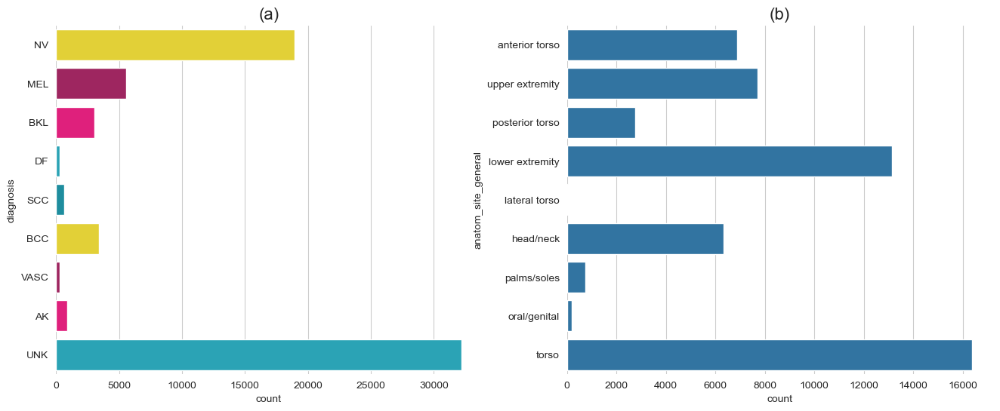

In [40]:
# Figure
f, (ax1, ax2) = plt.subplots(1, 2, figsize = (16, 6))

a = sns.countplot(train_df['diagnosis'], ax=ax1, palette = colors_nude)
b = sns.countplot(train_df['anatom_site_general'], ax=ax2)

# a.set_xticklabels(a.get_xticklabels(), rotation=35, ha="right", fontsize =14)
# b.set_xticklabels(b.get_xticklabels(), rotation=35, ha="right", fontsize =14)

# for p in a.patches:
#     a.annotate(format(p.get_height(), ','), 
#            (p.get_x() + p.get_width() / 2., 
#             p.get_height()), ha = 'center', va = 'center', 
#            xytext = (0, 6), textcoords = 'offset points', fontsize =12)
    
# for p in b.patches:
#     b.annotate(format(p.get_height(), ','), 
#            (p.get_x() + p.get_width() / 2., 
#             p.get_height()), ha = 'center', va = 'center', 
#            xytext = (0, 6), textcoords = 'offset points', fontsize =12)
    
ax1.set_title('(a)', fontsize=16)
ax2.set_title('(b)', fontsize=16)
sns.despine(left=True, bottom=True);

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Map 'male' to 1, 'female' to 0, and handle NaNs
train_df['sex'] = train_df['sex'].map({'male': 1, 'female': 0}).fillna(0).astype(int)
# Bin 'age_approx' to reduce unique values and improve performance
train_df['age'] = pd.cut(train_df['age_approx'], bins=10)

# Sample the dataset for faster visualization (remove or increase size for full dataset)
sample_df = train_df.sample(min(5000, len(train_df)), random_state=42)

# Create subplots
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))

# Count plots with optimized Seaborn syntax
sns.countplot(data=sample_df, x='age', ax=ax1)
sns.countplot(data=sample_df, x='sex', ax=ax2)

# Rotate labels for better readability
ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45, ha="right", fontsize=10)

# Set titles
ax1.set_title('(c) Age Distribution', fontsize=16)
ax2.set_title('(d) Sex Distribution', fontsize=16)

# Remove unnecessary spines
sns.despine(left=True, bottom=True)

# Show the plot
plt.tight_layout()
plt.show()

# Basic meta

In [42]:
import os
import pandas as pd

import matplotlib.pyplot as plt
from skimage import io
import random

In [43]:
PATH = './'
os.listdir(PATH)

['.ipynb_checkpoints',
 'conda_files',
 'content',
 'corrected_dataset_paths.csv',
 'data',
 'gpu_usage_test.py',
 'imagededup',
 'impl.py',
 'ISIC',
 'isic_pytorch.ipynb',
 'isic_pytorch_lightning.ipynb',
 'isic_pytorch_lightning_python_train.py',
 'isic_pytorch_lightning_update.ipynb',
 'output_descriptor',
 'output_label',
 'PJT_Datasets',
 'PJT_Datasets.rar',
 'rapidsai-csp-utils',
 'results',
 'Skin_Cancer_ISIC_Classification.ipynb',
 'skin_lesion_EDA_duplicates (1).ipynb',
 'skin_lesion_EDA_duplicates_1501.ipynb',
 'skin_lesion_EDA_duplicates_21_01.ipynb',
 'skin_lesion_EDA_duplicates_25_01.ipynb',
 'skin_lesion_EDA_duplicates_sush.ipynb',
 'submit_ood.ipynb',
 'test.csv',
 'test_path.csv',
 'train_2020.csv',
 'train_script_v1.py',
 'train_script_v2.py',
 'train_whole_60_no_duplicates.csv',
 'train_whole_meta.csv',
 'train_whole_no_duplicates.csv',
 'val_whole_60_no_duplicates.csv',
 'val_whole_meta.csv',
 'val_whole_no_duplicates.csv',
 'wandb',
 'whole_data.csv',
 'whole_data_n

In [44]:
train_target = pd.read_csv(f'{PATH}content/2019/train.csv')
train_target.head()

,image,MEL,NV,BCC,AK,BKL,DF,VASC,SCC,UNK
0,ISIC_0000000,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,ISIC_0000001,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,ISIC_0000002,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,ISIC_0000003,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,ISIC_0000004,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [46]:
train = pd.read_csv(f'{PATH}/content/2019/ISIC_2019_Training_Metadata.csv')
train.head()

,image,age_approx,anatom_site_general,lesion_id,sex
0,ISIC_0000000,55.0,anterior torso,NaN,female
1,ISIC_0000001,30.0,anterior torso,NaN,female
2,ISIC_0000002,60.0,upper extremity,NaN,female
3,ISIC_0000003,30.0,upper extremity,NaN,male
4,ISIC_0000004,80.0,posterior torso,NaN,male


In [47]:
test = pd.read_csv(f'{PATH}/content/2019/test/ISIC_2019_Test_Metadata.csv')
test.head()

,image,age_approx,anatom_site_general,sex
0,ISIC_0034321,60.0,NaN,female
1,ISIC_0034322,70.0,anterior torso,male
2,ISIC_0034323,70.0,lower extremity,male
3,ISIC_0034324,70.0,lower extremity,male
4,ISIC_0034325,30.0,upper extremity,female


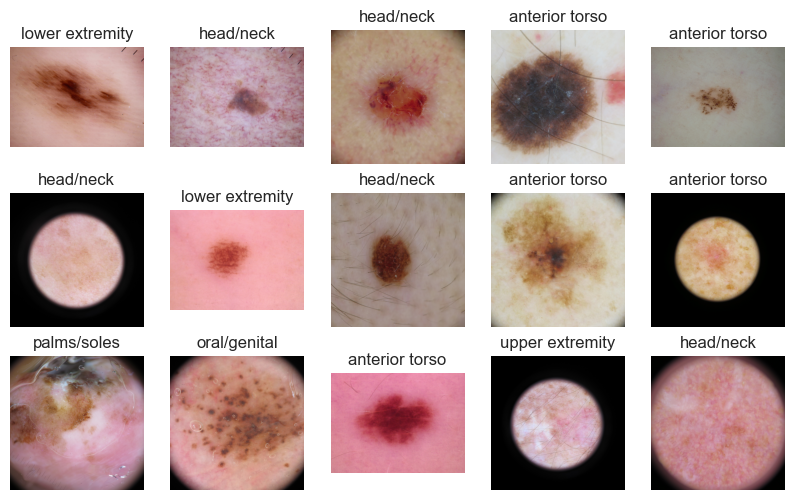

In [59]:
r, c = 3, 5
fig = plt.figure(figsize=(2*c, 2*r))
for _r in range(r):
    for _c in range(c):
        plt.subplot(r, c, _r*c + _c + 1)
        ix = random.randint(0, len(train))
        name = train["image"].values[ix]
        img = io.imread(f'{PATH}/content/2019/train/{name}.jpg')
        plt.imshow(img)
        label = train["anatom_site_general"].values[ix]
        plt.title(label)
        plt.axis(False)
plt.show()

In [51]:
for col in train_target.columns:
    print(train_target[col].value_counts())
    print("\n")

image
ISIC_0000000    1
ISIC_0059830    1
ISIC_0059827    1
ISIC_0059826    1
ISIC_0059824    1
               ..
ISIC_0029844    1
ISIC_0029843    1
ISIC_0029842    1
ISIC_0029841    1
ISIC_0073254    1
Name: count, Length: 25331, dtype: int64


MEL
0.0    20809
1.0     4522
Name: count, dtype: int64


NV
1.0    12875
0.0    12456
Name: count, dtype: int64


BCC
0.0    22008
1.0     3323
Name: count, dtype: int64


AK
0.0    24464
1.0      867
Name: count, dtype: int64


BKL
0.0    22707
1.0     2624
Name: count, dtype: int64


DF
0.0    25092
1.0      239
Name: count, dtype: int64


VASC
0.0    25078
1.0      253
Name: count, dtype: int64


SCC
0.0    24703
1.0      628
Name: count, dtype: int64


UNK
0.0    25331
Name: count, dtype: int64




array([[<Axes: title={'center': 'MEL'}>, <Axes: title={'center': 'NV'}>,
        <Axes: title={'center': 'BCC'}>],
       [<Axes: title={'center': 'AK'}>, <Axes: title={'center': 'BKL'}>,
        <Axes: title={'center': 'DF'}>],
       [<Axes: title={'center': 'VASC'}>,
        <Axes: title={'center': 'SCC'}>, <Axes: title={'center': 'UNK'}>]],
      dtype=object)

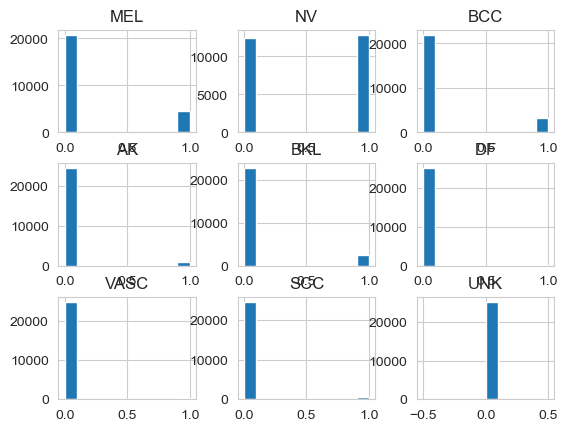

In [52]:
train_target.hist()

<Axes: >

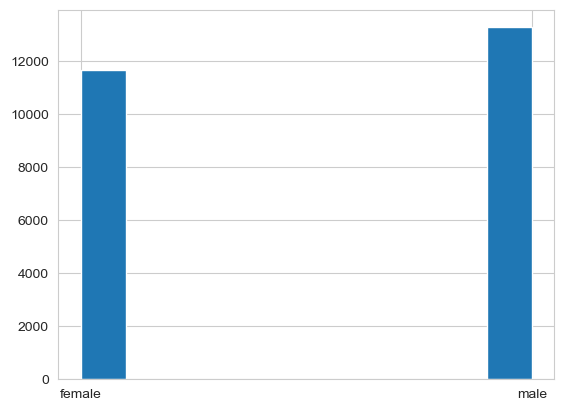

In [53]:
train['sex'].hist()

<Axes: >

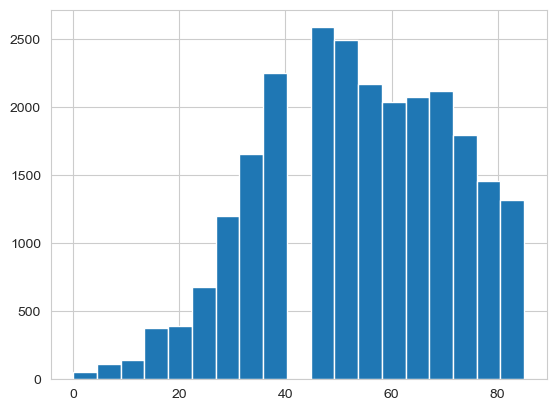

In [54]:
train['age_approx'].hist(bins=len(train['age_approx'].unique()))

In [55]:
train['age_approx'].value_counts()

age_approx
45.0    2585
50.0    2489
40.0    2246
55.0    2170
70.0    2120
65.0    2075
60.0    2036
75.0    1796
35.0    1651
80.0    1459
85.0    1319
30.0    1199
25.0     677
20.0     388
15.0     375
10.0     142
5.0      113
0.0       54
Name: count, dtype: int64

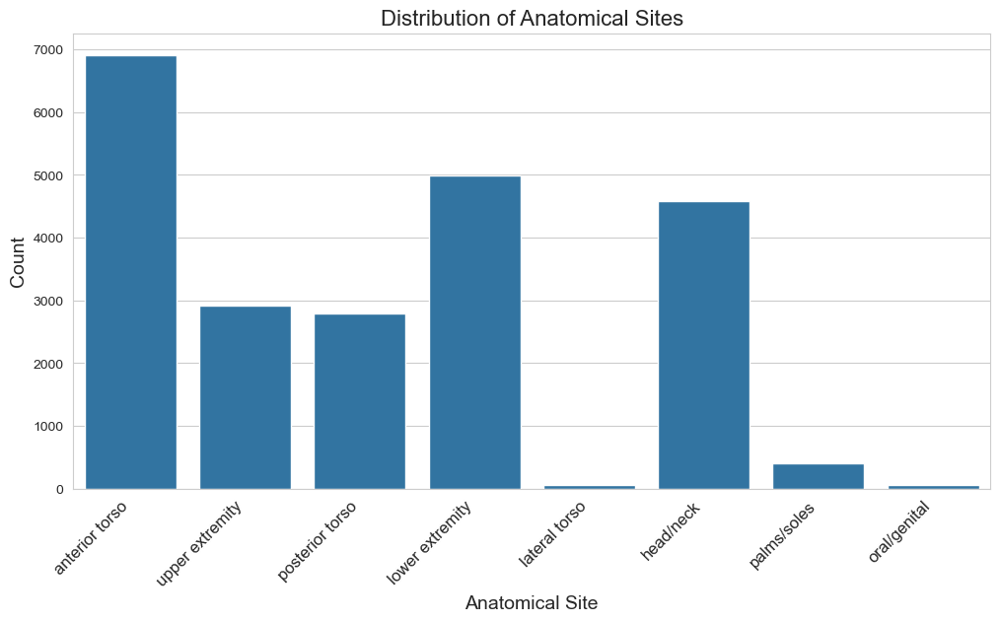

In [60]:
plt.figure(figsize=(12, 6))  # Set figure size
sns.countplot(data=train, x='anatom_site_general')

plt.xticks(rotation=45, ha='right', fontsize=12)  # Rotate and adjust labels
plt.xlabel("Anatomical Site", fontsize=14)
plt.ylabel("Count", fontsize=14)
plt.title("Distribution of Anatomical Sites", fontsize=16)

plt.show()

In [61]:
train.shape, test.shape

((25331, 5), (8238, 4))

In [63]:
train = pd.read_csv(f'results/whole_data_no_duplicates.csv').reset_index(drop=True)

In [64]:
from sklearn.model_selection import train_test_split

train_split, val_split = train_test_split(train, random_state=42, test_size=0.33, shuffle=True, stratify=train['target'])

train_split.shape, val_split.shape

((43726, 8), (21538, 8))

In [65]:
((22194, 8), (10932, 8))
train_split.to_csv(f'results/train_split.csv', index=False)
val_split.to_csv(f'results/val_split.csv', index=False)

In [66]:
_, subset = train_test_split(train_split, random_state=42, test_size=0.1, shuffle=True, stratify=train_split['target'])
subset.shape

(4373, 8)

In [67]:
subset.to_csv(f'results/subset.csv', index=False)